| **Ticker**      | **Index Name**                        | **Region**          | **Description**                                                                 |
|------------------|---------------------------------------|---------------------|---------------------------------------------------------------------------------|
| **AAPL**         | Apple Inc.                          | Global (Stock)      | Major technology company and one of the most valuable companies in the world.  |
| **MSFT**         | Microsoft Corp.                     | Global (Stock)      | Leading software and cloud services company.                                   |
| **GOOG**         | Alphabet Inc. (Google)              | Global (Stock)      | Parent company of Google, focused on internet-related services and products.  |
| **^GSPC**        | S&P 500                             | North America (USA) | Tracks the 500 largest publicly traded companies in the U.S.                  |
| **^DJI**         | Dow Jones Industrial Average        | North America (USA) | Index of 30 major industrial companies in the U.S.                            |
| **^IXIC**        | Nasdaq Composite                    | North America (USA) | Index focused on technology and innovation-driven companies.                  |
| **^GSPTSE**      | S&P/TSX Composite                   | North America (Canada)| Tracks the performance of the largest companies on the Toronto Stock Exchange.|
| **^MXX**         | IPC México                          | Latin America (Mexico)| Tracks the largest companies listed on the Mexican Stock Exchange (BMV).     |
| **^BVSP**        | Bovespa                             | Latin America (Brazil)| Tracks the performance of companies listed on the São Paulo Stock Exchange.  |
| **^FTSE**        | FTSE 100                            | Europe (UK)         | Tracks the 100 largest companies listed on the London Stock Exchange.         |
| **^GDAXI**       | DAX 40                              | Europe (Germany)    | Tracks the 40 largest publicly traded companies on the Frankfurt Stock Exchange.|
| **^FCHI**        | CAC 40                              | Europe (France)     | Tracks the 40 largest companies listed on the Paris Stock Exchange.           |
| **^IBEX**        | IBEX 35                             | Europe (Spain)      | Tracks the 35 most liquid stocks on the Madrid Stock Exchange.                |
| **^STOXX50E**    | Euro Stoxx 50                       | Europe (Eurozone)   | Tracks the 50 largest companies from the Eurozone.                            |
| **FTSEMIB.MI**   | FTSE MIB                            | Europe (Italy)      | Tracks the 40 largest companies listed on the Italian Stock Exchange.         |
| **^N225**        | Nikkei 225                          | Asia (Japan)        | Tracks the 225 largest publicly traded companies on the Tokyo Stock Exchange. |
| **^HSI**         | Hang Seng Index                     | Asia (Hong Kong)    | Tracks the largest companies listed in Hong Kong.                             |
| **000001.SS**    | Shanghai Composite                  | Asia (China)        | Tracks all companies listed on the Shanghai Stock Exchange.                   |
| **^BSESN**       | Sensex                              | Asia (India)        | Tracks the 30 largest companies listed on the Bombay Stock Exchange.          |
| **^NSEI**        | Nifty 50                            | Asia (India)        | Tracks the 50 largest companies listed on the National Stock Exchange of India.|
| **^KS11**        | KOSPI                               | Asia (South Korea)  | Tracks the performance of companies listed on the Korea Exchange.             |
| **^TWII**        | Taiwan Weighted Index               | Asia (Taiwan)       | Tracks the largest companies listed on the Taiwan Stock Exchange.             |
| **^AXJO**        | S&P/ASX 200                         | Oceania (Australia) | Tracks the 200 largest companies listed on the Australian Securities Exchange.|
| **^MSCI**        | MSCI World Index                   | Global              | Tracks large and mid-cap companies across 23 developed markets.               |
| **^MSCIEF**      | MSCI Emerging Markets Index        | Global              | Tracks companies from 26 emerging markets.                                    |


In [1]:
import yfinance as yf
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
from statsmodels.tsa.arima.model import ARIMA
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np

In [16]:
# List of assets (stocks and indices)
assets = [
    # Key Stocks (Optional for Comparison)
    "AAPL", "MSFT", "GOOG",

    # North America
    "^GSPC",     # S&P 500 (USA)
    "^DJI",      # Dow Jones Industrial Average (USA)
    "^IXIC",     # Nasdaq Composite (USA)
    "^GSPTSE",   # S&P/TSX Composite (Canada)

    # Latin America
    "^MXX",      # IPC México (Mexico)
    "^BVSP",     # Bovespa (Brazil)

    # Europe
    "^FTSE",     # FTSE 100 (UK)
    "^GDAXI",    # DAX 40 (Germany)
    "^FCHI",     # CAC 40 (France)
    "^IBEX",     # IBEX 35 (Spain)
    "^STOXX50E", # Euro Stoxx 50 (Eurozone)
    "FTSEMIB.MI",# FTSE MIB (Italy)

    # Asia
    "^N225",     # Nikkei 225 (Japan)
    "^HSI",      # Hang Seng (Hong Kong)
    "000001.SS", # Shanghai Composite (China)
    "^BSESN",    # Sensex (India)
    "^NSEI",     # Nifty 50 (India)
    "^KS11",     # KOSPI (South Korea)
    "^TWII",     # Taiwan Weighted (Taiwan)

    # Oceania
    "^AXJO",     # S&P/ASX 200 (Australia)

    # Global Indices
    "^MSCI",     # MSCI World Index
    "^MSCIEF"    # MSCI Emerging Markets Index
]

# Initialize an empty DataFrame
pf_data = pd.DataFrame()

# Fetch data for each asset
for a in assets:
    data = yf.download(a, start="2010-01-01")
    pf_data[a] = data['Close']

# Preview the downloaded data
pf_data.head()

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%********

,AAPL,MSFT,GOOG,^GSPC,^DJI,^IXIC,^GSPTSE,^MXX,^BVSP,^FTSE,...,^N225,^HSI,000001.SS,^BSESN,^NSEI,^KS11,^TWII,^AXJO,^MSCI,^MSCIEF
Date,,,,,,,,,,,,,,,,,,,,,
2010-01-04,6.447412,23.300684,15.554351,1132.989990,10583.959961,2308.419922,11866.900391,32758.529297,70045.0,5500.299805,...,10654.790039,21823.279297,3243.760010,17558.730469,5232.200195,1696.140015,8207.809570,4876.299805,NaN,NaN
2010-01-05,6.458560,23.308210,15.485855,1136.520020,10572.019531,2308.709961,11888.099609,32732.759766,70240.0,5522.500000,...,10681.830078,22279.580078,3282.178955,17686.240234,5277.899902,1690.619995,8211.360352,4924.299805,NaN,NaN
2010-01-06,6.355827,23.165169,15.095476,1137.140015,10573.679688,2301.090088,11944.500000,32830.160156,70729.0,5530.000000,...,10731.450195,22416.669922,3254.215088,17701.130859,5281.799805,1705.319946,8327.580078,4921.399902,NaN,NaN
2010-01-07,6.344077,22.924252,14.744061,1141.689941,10606.860352,2300.050049,11887.500000,33064.570312,70451.0,5526.700195,...,10681.660156,22269.449219,3192.775879,17615.720703,5263.100098,1683.449951,8237.379883,4899.399902,NaN,NaN
2010-01-08,6.386254,23.082350,14.940614,1144.979980,10618.190430,2317.169922,11953.799805,32892.039062,70263.0,5534.200195,...,10798.320312,22296.750000,3195.997070,17540.289062,5244.750000,1695.260010,8280.860352,4912.100098,NaN,NaN


In [17]:
# Normalize prices (Base = 100)
normalized_pf_data = (pf_data / pf_data.iloc[0]) * 100

# Plot normalized prices (using Plotly for interactivity)
import plotly.express as px

px.line(normalized_pf_data, title="Normalized Prices for Stocks and Indices (Base = 100)")

In [18]:
# Resample data to weekly intervals
pf_data_weekly = pf_data.resample('W').mean()

# Split into training and testing sets (80/20 split)
train_size = int(len(pf_data_weekly) * 0.8)
train_data = pf_data_weekly.iloc[:train_size]
test_data = pf_data_weekly.iloc[train_size:]

# Preview training and testing data
print("Training Data:", train_data.shape)
print("Testing Data:", test_data.shape)

Training Data: (624, 25)
Testing Data: (157, 25)


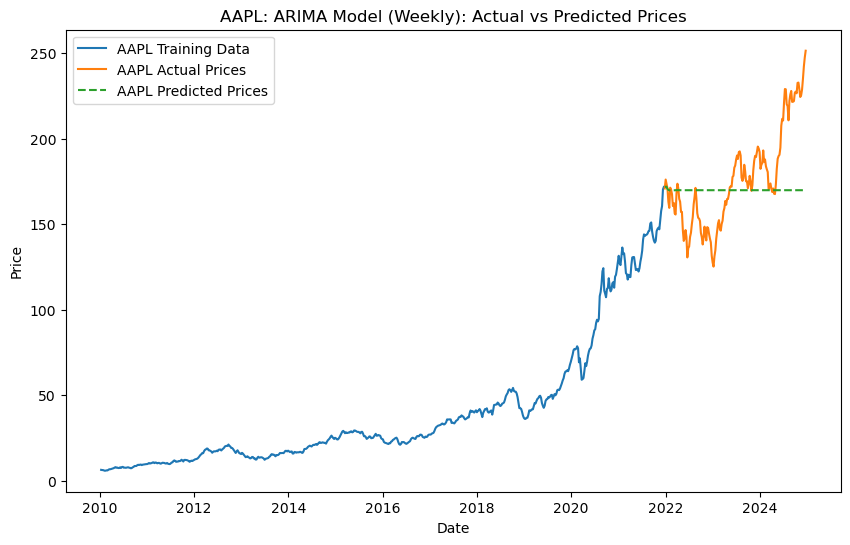

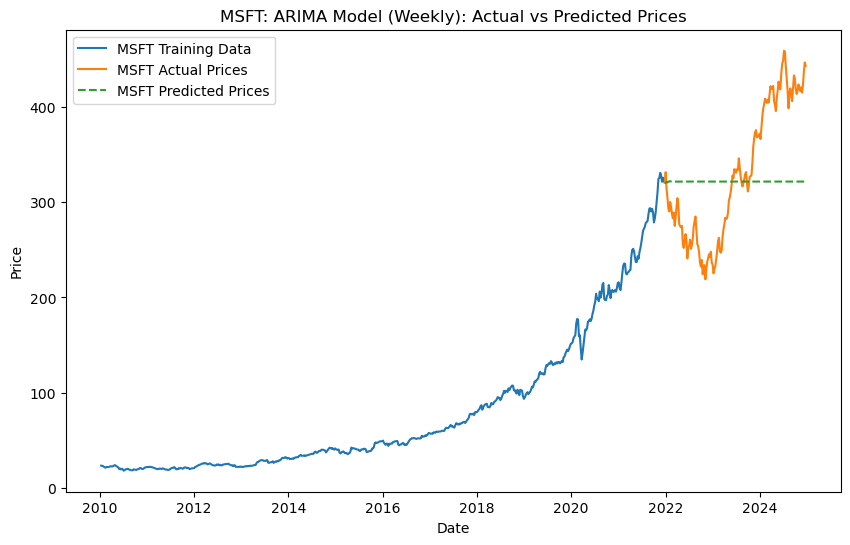

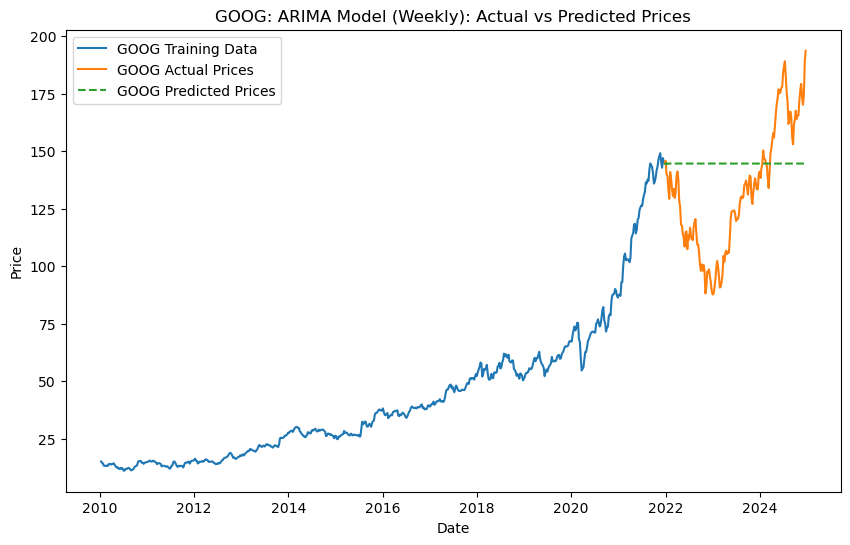

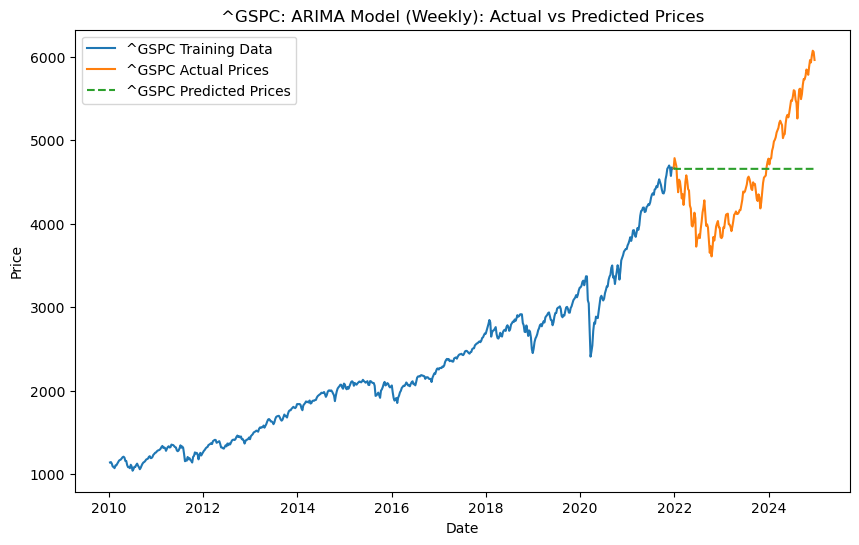

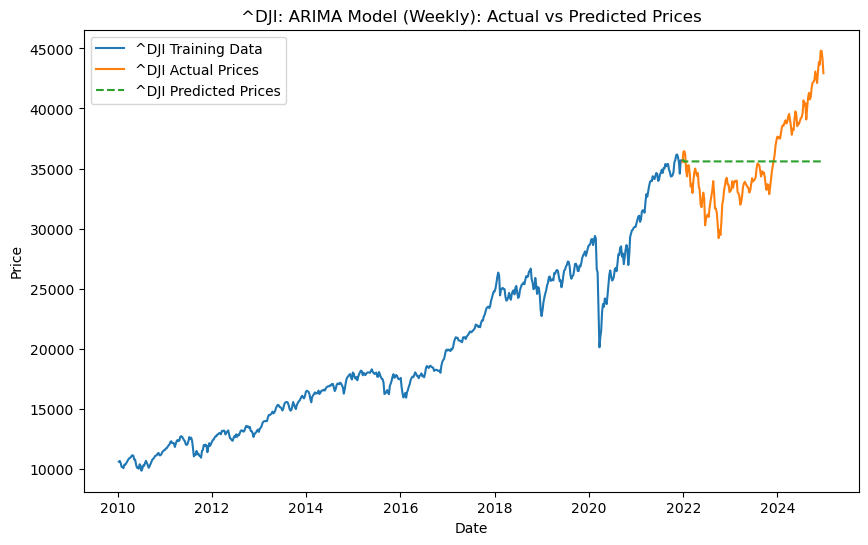

...

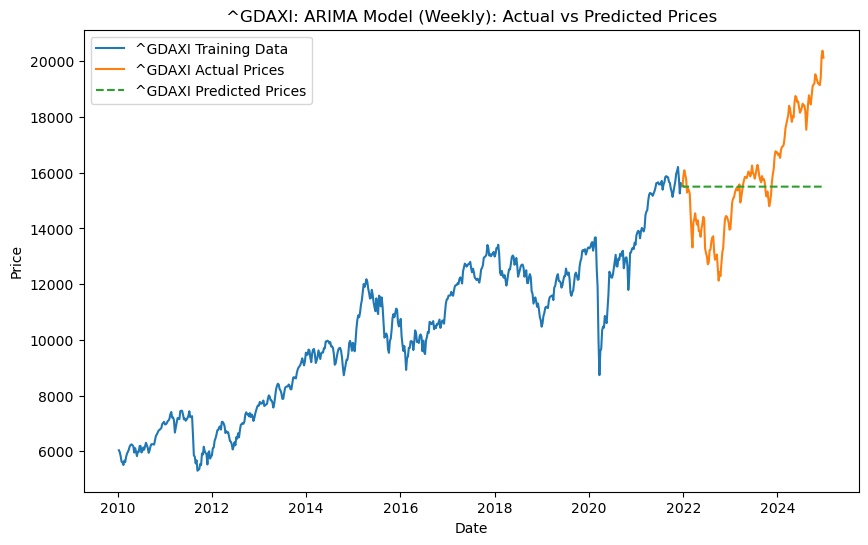

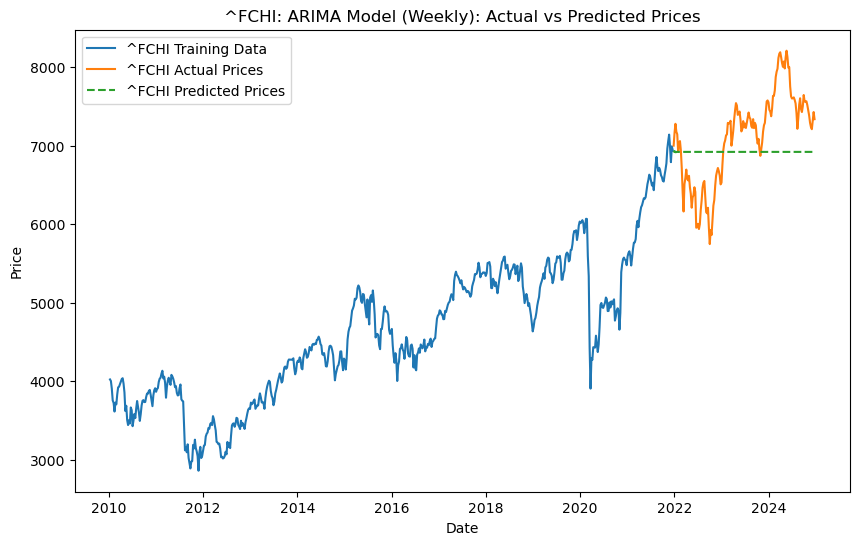

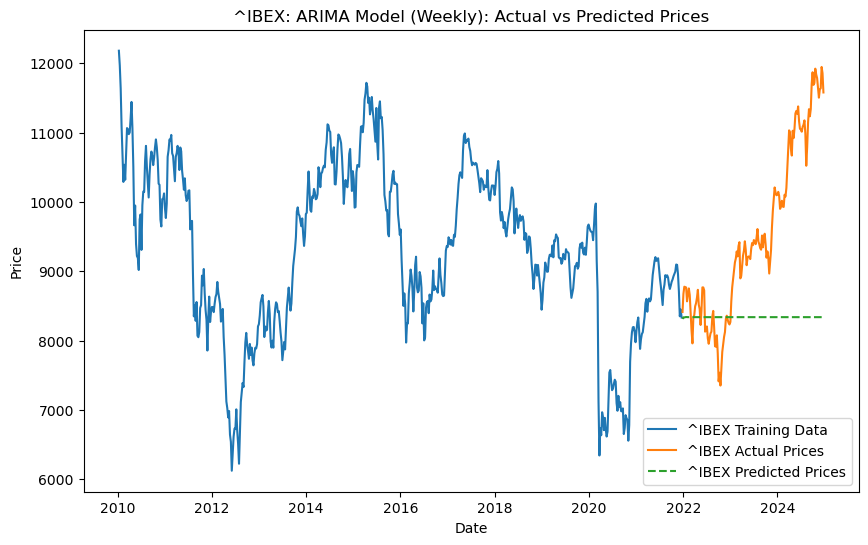

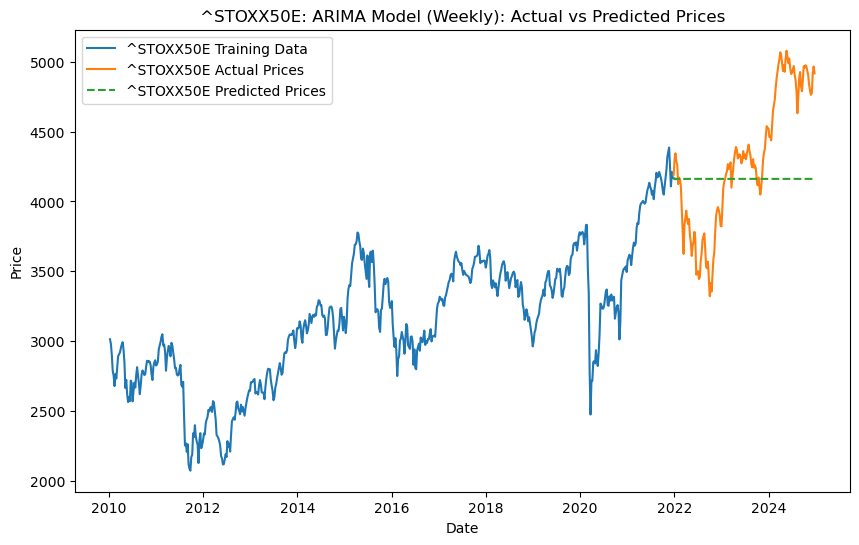

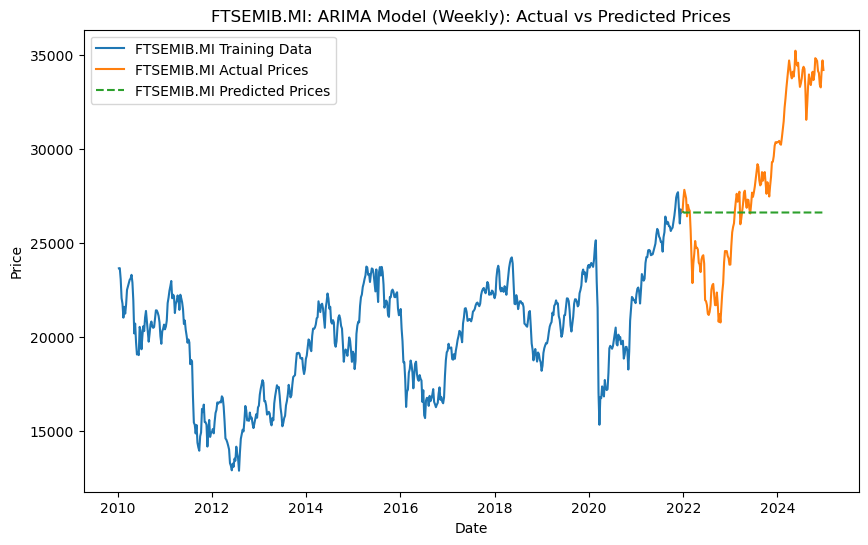

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning:

No supported index i

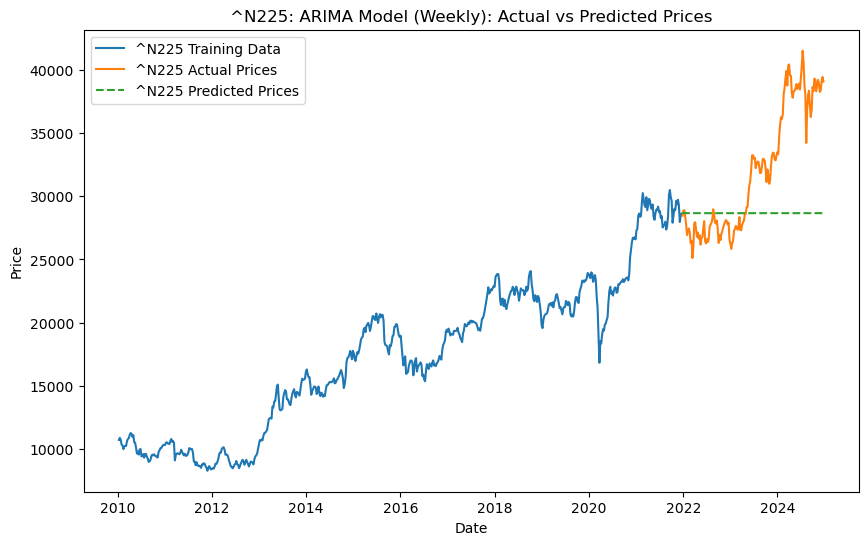

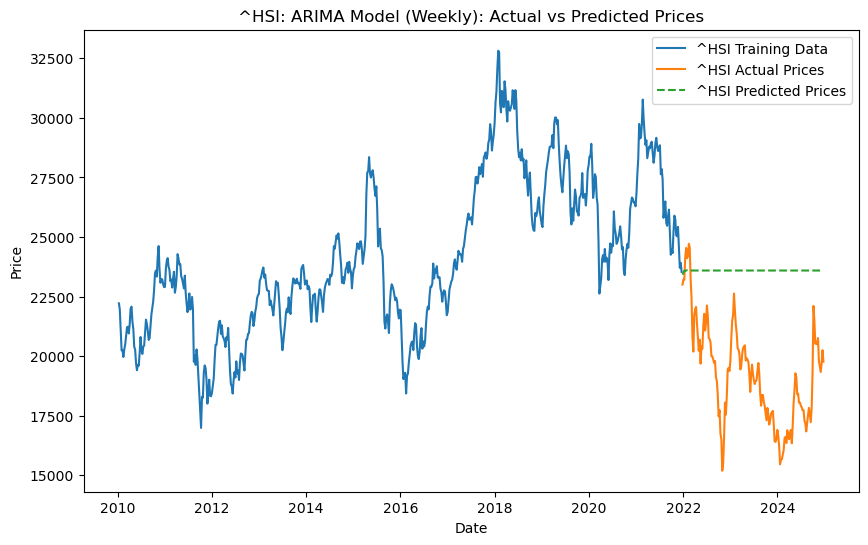

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning:

No supported index i

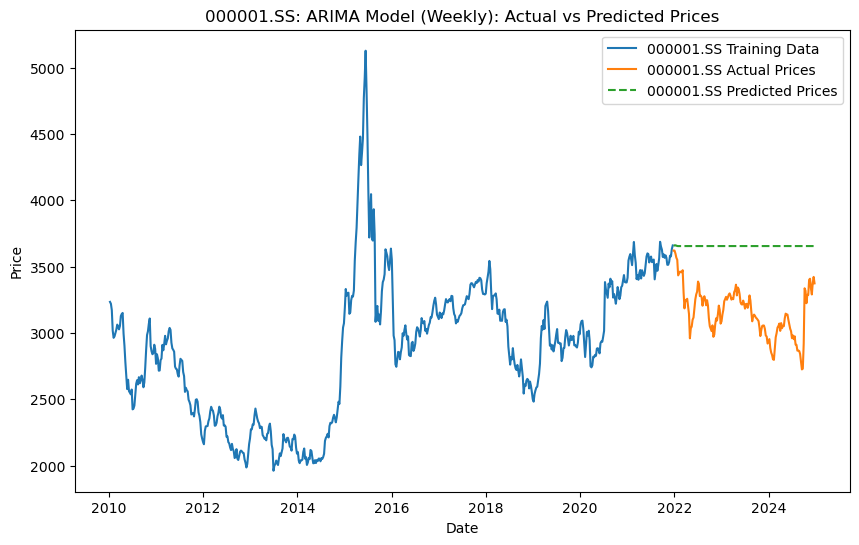

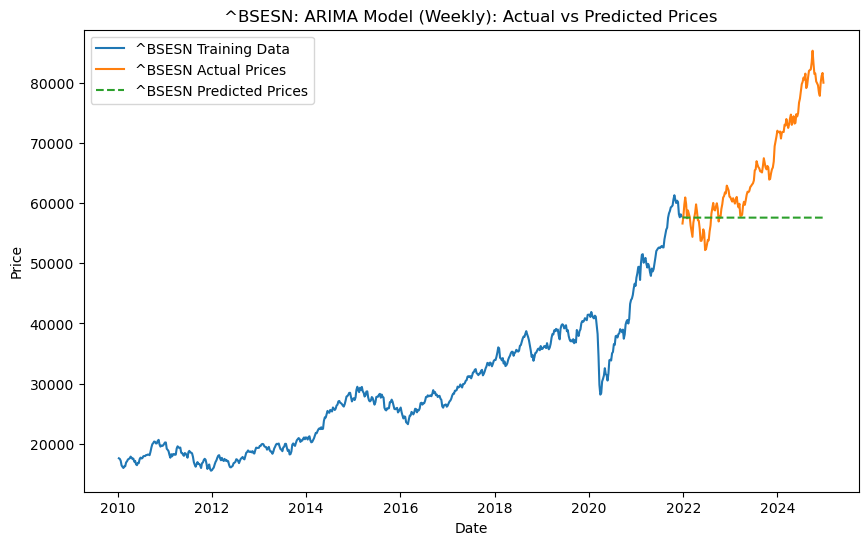

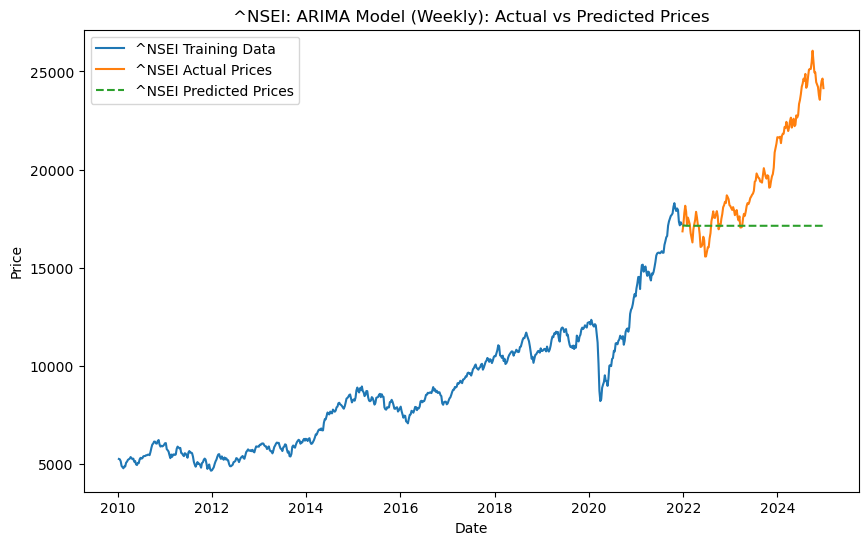

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning:

No supported index i

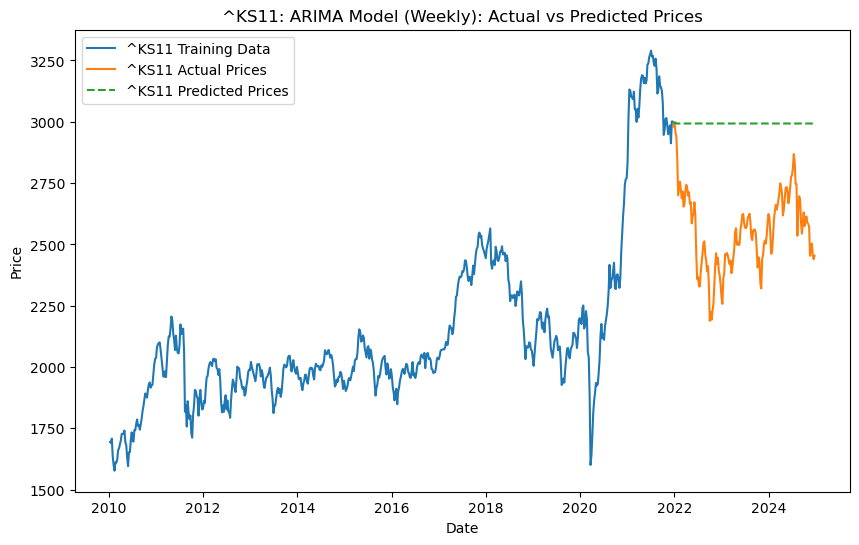

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning:

No supported index i

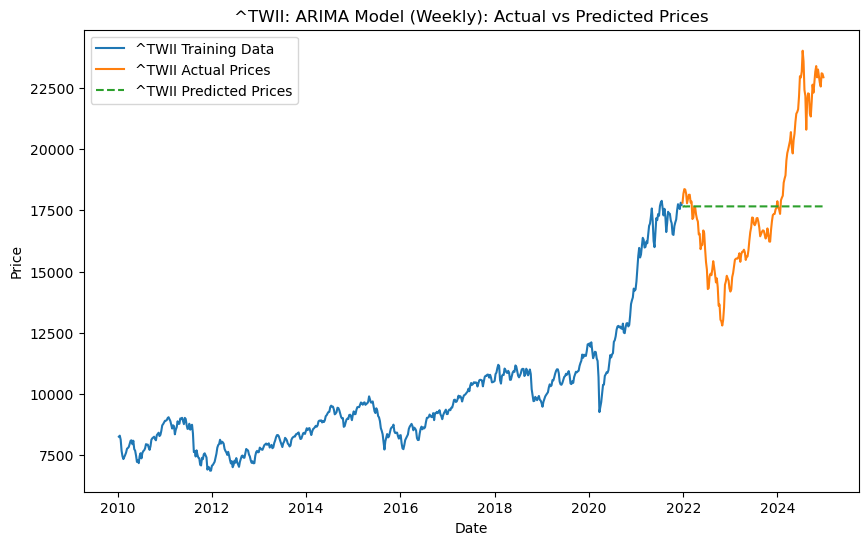

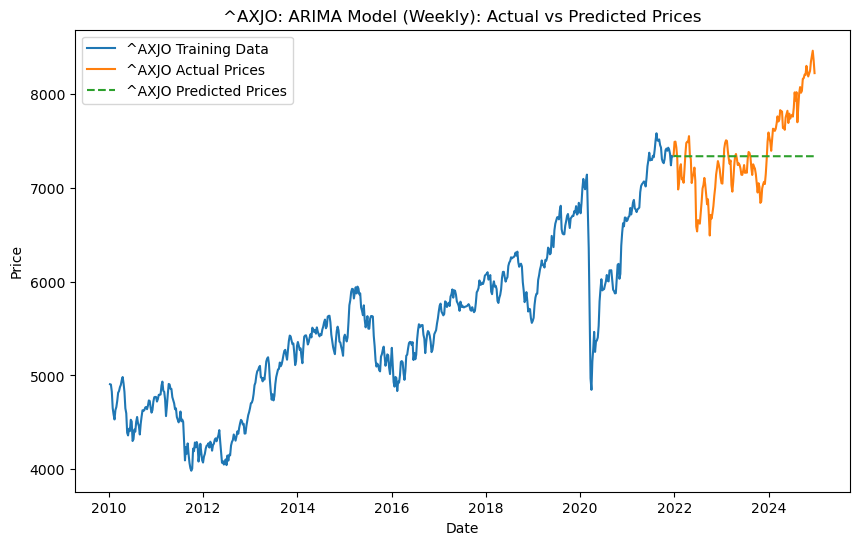

Could not process ^MSCI: Schur decomposition solver error.
Could not process ^MSCIEF: Schur decomposition solver error.


/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning:

Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.

/opt/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3787: RuntimeWarning:

Degrees of freedom <= 0 for slice

/opt/anaconda3/lib/python3.11/site-packages/numpy/core/_methods.py:163: RuntimeWarning:

invalid value encountered in divide

/opt/anaconda3/lib/python3.11/site-packages/numpy/core/_methods.py:198: RuntimeWarning:

invalid value encountered in scalar divide

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:534: RuntimeWarning:

invalid value encountered in scalar divide



In [19]:
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt

# Loop through each ticker
for ticker in assets:
    # Train ARIMA on the training data for this ticker
    train = train_data[ticker].dropna()  # Ensure no NaN values
    test = test_data[ticker].dropna()  # Ensure no NaN values

    try:
        # Fit ARIMA model
        arima_model = ARIMA(train, order=(5, 1, 0))  # Adjust (p, d, q) as needed
        arima_result = arima_model.fit()

        # Forecast for the test period
        forecast = arima_result.forecast(steps=len(test))

        # Plot actual vs. predicted prices
        plt.figure(figsize=(10, 6))
        plt.plot(train.index, train, label=f"{ticker} Training Data")
        plt.plot(test.index, test, label=f"{ticker} Actual Prices")
        plt.plot(test.index, forecast, label=f"{ticker} Predicted Prices", linestyle='--')
        plt.title(f"{ticker}: ARIMA Model (Weekly): Actual vs Predicted Prices")
        plt.xlabel("Date")
        plt.ylabel("Price")
        plt.legend()
        plt.show()

    except Exception as e:
        print(f"Could not process {ticker}: {e}")

In [57]:
import plotly.graph_objects as go
from statsmodels.tsa.arima.model import ARIMA

# Loop through each ticker
for ticker in assets:
    # Train ARIMA on the training data for this ticker
    train = train_data[ticker].dropna()  # Ensure no NaN values
    test = test_data[ticker].dropna()  # Ensure no NaN values

    try:
        # Fit ARIMA model
        arima_model = ARIMA(train, order=(5, 1, 0))  # Adjust (p, d, q) as needed
        arima_result = arima_model.fit()

        # Forecast for the test period
        forecast = arima_result.forecast(steps=len(test))

        # Create a Plotly figure
        fig = go.Figure()

        # Add training data
        fig.add_trace(go.Scatter(
            x=train.index, 
            y=train, 
            mode='lines', 
            name=f"{ticker} Training Data",
            line=dict(color='blue')
        ))

        # Add actual test data
        fig.add_trace(go.Scatter(
            x=test.index, 
            y=test, 
            mode='lines', 
            name=f"{ticker} Actual Prices",
            line=dict(color='cyan')
        ))

        # Add forecasted data
        fig.add_trace(go.Scatter(
            x=test.index, 
            y=forecast, 
            mode='lines', 
            name=f"{ticker} Predicted Prices",
            line=dict(dash='dash', color='yellow')
        ))

        # Update layout for dark background and styling
        fig.update_layout(
            template="plotly_dark",
            title=f"{ticker}: ARIMA Model (Weekly): Actual vs Predicted Prices",
            xaxis_title="Date",
            yaxis_title="Price",
            legend=dict(font=dict(size=12)),
            margin=dict(l=50, r=50, t=50, b=50),
            plot_bgcolor='black',
            paper_bgcolor='black'
        )

        # Show the figure
        fig.show()

    except Exception as e:
        print(f"Could not process {ticker}: {e}")

In [20]:
#5. Evaluate the Model
#For each ticker, calculate evaluation metrics:
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np

for ticker in assets:
    train = train_data[ticker].dropna()
    test = test_data[ticker].dropna()

    try:
        # Fit ARIMA model
        arima_model = ARIMA(train, order=(5, 1, 0))
        arima_result = arima_model.fit()

        # Forecast for the test period
        forecast = arima_result.forecast(steps=len(test))

        # Calculate metrics
        mae = mean_absolute_error(test, forecast)
        rmse = np.sqrt(mean_squared_error(test, forecast))
        print(f"{ticker}: MAE = {mae:.2f}, RMSE = {rmse:.2f}")

    except Exception as e:
        print(f"Could not process {ticker}: {e}")

AAPL: MAE = 22.29, RMSE = 29.29
MSFT: MAE = 61.67, RMSE = 71.20
GOOG: MAE = 25.04, RMSE = 29.56
^GSPC: MAE = 558.06, RMSE = 648.49
^DJI: MAE = 2982.35, RMSE = 3580.85
^IXIC: MAE = 2427.07, RMSE = 2768.86
^GSPTSE: MAE = 1195.00, RMSE = 1599.07
^MXX: MAE = 2573.98, RMSE = 3114.10
^BVSP: MAE = 11344.56, RMSE = 13960.38
^FTSE: MAE = 489.66, RMSE = 592.15
^GDAXI: MAE = 1631.24, RMSE = 2042.23
^FCHI: MAE = 527.82, RMSE = 611.10
^IBEX: MAE = 1308.57, RMSE = 1701.88
^STOXX50E: MAE = 415.25, RMSE = 503.18
FTSEMIB.MI: MAE = 3714.23, RMSE = 4543.76
^N225: MAE = 4516.91, RMSE = 5923.22
^HSI: MAE = 4445.93, RMSE = 4870.72
000001.SS: MAE = 497.48, RMSE = 529.21


/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning:

No supported index i

^BSESN: MAE = 9132.15, RMSE = 12171.98
^NSEI: MAE = 2863.89, RMSE = 3893.52
^KS11: MAE = 435.90, RMSE = 462.84
^TWII: MAE = 2323.92, RMSE = 2874.86
^AXJO: MAE = 347.46, RMSE = 438.85
Could not process ^MSCI: Schur decomposition solver error.
Could not process ^MSCIEF: Schur decomposition solver error.


/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning:

No supported index i

In [22]:
# Prepare actual data
actual_data = pd.melt(
    test_data.reset_index(), 
    id_vars=['Date'], 
    value_vars=assets, 
    var_name='Ticker', 
    value_name='Actual'
)

In [23]:
# Initialize an empty DataFrame for forecasted data
forecast_data_list = []

for ticker in assets:
    try:
        # Train ARIMA on the training data for this ticker
        train = train_data[ticker].dropna()
        test = test_data[ticker].dropna()

        arima_model = ARIMA(train, order=(5, 1, 0))  # Adjust order if needed
        arima_result = arima_model.fit()

        # Forecast for the test period
        forecast = arima_result.forecast(steps=len(test))

        # Append forecasted data
        forecast_data_list.append(
            pd.DataFrame({
                'Date': test.index,
                'Ticker': ticker,
                'Forecast': forecast
            })
        )
    except Exception as e:
        print(f"Could not process {ticker}: {e}")

# Combine all forecasted data into a single DataFrame
forecast_data = pd.concat(forecast_data_list, ignore_index=True)

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning:

No supported index i

Could not process ^MSCI: Schur decomposition solver error.
Could not process ^MSCIEF: Schur decomposition solver error.


/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

/opt/anaconda3/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning:

No supported index i

In [24]:
# Combine actual and forecast data
combined_data = pd.merge(actual_data, forecast_data, on=["Date", "Ticker"], how="outer")

In [25]:
import plotly.graph_objects as go

# Initialize Plotly figure
fig = go.Figure()

# Add lines for each ticker's actual and forecast data
for ticker in combined_data["Ticker"].unique():
    ticker_data = combined_data[combined_data["Ticker"] == ticker]
    
    # Add actual data line
    fig.add_trace(
        go.Scatter(
            x=ticker_data["Date"],
            y=ticker_data["Actual"],
            mode="lines",
            name=f"{ticker} Actual",
            line=dict(color="blue"),
        )
    )
    
    # Add forecast data line
    fig.add_trace(
        go.Scatter(
            x=ticker_data["Date"],
            y=ticker_data["Forecast"],
            mode="lines",
            name=f"{ticker} Forecast",
            line=dict(dash="dash", color="red"),
        )
    )

# Update layout for clarity
fig.update_layout(
    title="Actual vs Forecast Prices for All Tickers",
    xaxis_title="Date",
    yaxis_title="Price",
    legend_title="Legend",
    template="plotly_white"
)

# Show the plot
fig.show()

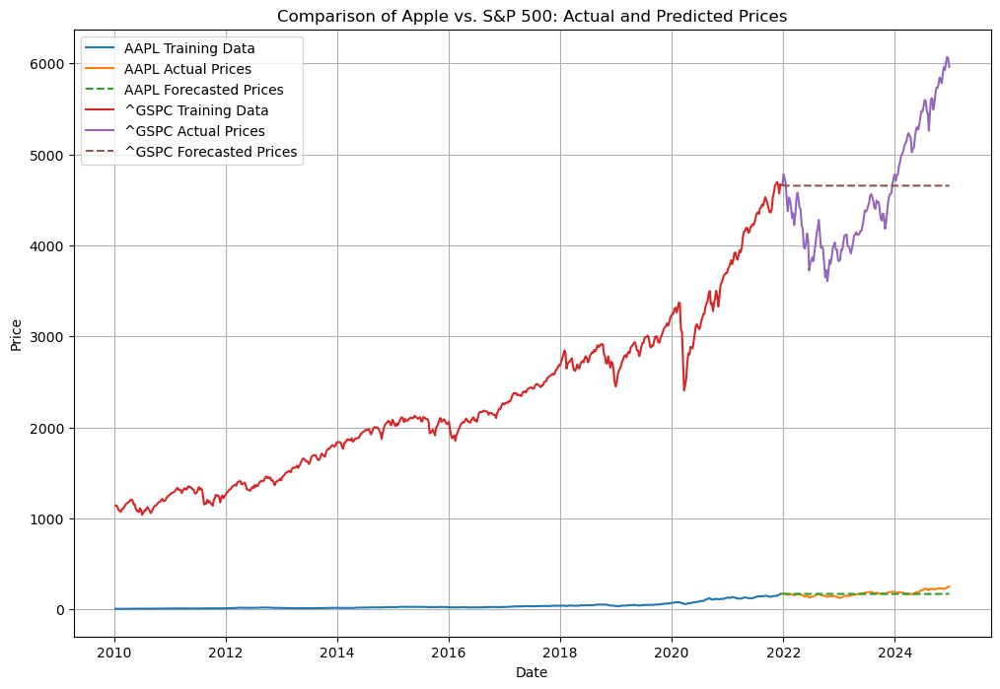

In [29]:
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt

# Define the tickers to compare
tickers_to_compare = ["AAPL", "^GSPC"]

# Initialize a dictionary to store results
forecasts = {}

for ticker in tickers_to_compare:
    # Train ARIMA on the training data for this ticker
    train = train_data[ticker].dropna()  # Ensure no NaN values
    test = test_data[ticker].dropna()  # Ensure no NaN values

    try:
        # Fit ARIMA model
        arima_model = ARIMA(train, order=(5, 1, 0))  # Adjust (p, d, q) as needed
        arima_result = arima_model.fit()

        # Forecast for the test period
        forecast = arima_result.forecast(steps=len(test))

        # Save actual and forecast data for plotting
        forecasts[ticker] = {
            "train": train,
            "test": test,
            "forecast": forecast
        }

    except Exception as e:
        print(f"Could not process {ticker}: {e}")

# Plot Apple vs. S&P 500
plt.figure(figsize=(12, 8))

for ticker in tickers_to_compare:
    data = forecasts[ticker]
    
    # Plot training data
    plt.plot(data["train"].index, data["train"], label=f"{ticker} Training Data")
    
    # Plot actual test data
    plt.plot(data["test"].index, data["test"], label=f"{ticker} Actual Prices")
    
    # Plot forecasted data
    plt.plot(data["test"].index, data["forecast"], label=f"{ticker} Forecasted Prices", linestyle="--")

# Add title and labels
plt.title("Comparison of Apple vs. S&P 500: Actual and Predicted Prices")
plt.xlabel("Date")
plt.ylabel("Price")
plt.legend()
plt.grid()
plt.show()

In [56]:
import plotly.graph_objects as go
from statsmodels.tsa.arima.model import ARIMA

# Define the tickers to compare
tickers_to_compare = ["AAPL", "^GSPC"]

# Initialize a dictionary to store results
forecasts = {}

for ticker in tickers_to_compare:
    # Train ARIMA on the training data for this ticker
    train = train_data[ticker].dropna()  # Ensure no NaN values
    test = test_data[ticker].dropna()  # Ensure no NaN values

    try:
        # Fit ARIMA model
        arima_model = ARIMA(train, order=(5, 1, 0))  # Adjust (p, d, q) as needed
        arima_result = arima_model.fit()

        # Forecast for the test period
        forecast = arima_result.forecast(steps=len(test))

        # Save actual and forecast data for plotting
        forecasts[ticker] = {
            "train": train,
            "test": test,
            "forecast": forecast
        }

    except Exception as e:
        print(f"Could not process {ticker}: {e}")

# Create a Plotly figure
fig = go.Figure()

# Plot data for each ticker
for ticker in tickers_to_compare:
    if ticker in forecasts:
        data = forecasts[ticker]

        # Add training data
        fig.add_trace(go.Scatter(
            x=data["train"].index, 
            y=data["train"], 
            mode='lines', 
            name=f"{ticker} Training Data",
            line=dict(color='blue' if ticker == "AAPL" else 'green')
        ))

        # Add actual test data
        fig.add_trace(go.Scatter(
            x=data["test"].index, 
            y=data["test"], 
            mode='lines', 
            name=f"{ticker} Actual Prices",
            line=dict(color='cyan' if ticker == "AAPL" else 'lime')
        ))

        # Add forecasted data
        fig.add_trace(go.Scatter(
            x=data["test"].index, 
            y=data["forecast"], 
            mode='lines', 
            name=f"{ticker} Forecasted Prices",
            line=dict(dash='dash', color='blue' if ticker == "AAPL" else 'green')
        ))

# Update layout for dark background and styling
fig.update_layout(
    template="plotly_dark",
    title="Comparison of Apple vs. S&P 500: Actual and Predicted Prices ARIMA Model",
    xaxis_title="Date",
    yaxis_title="Price",
    legend=dict(font=dict(size=12), orientation="h", x=0.1, y=-0.2),
    margin=dict(l=50, r=50, t=50, b=50),
    plot_bgcolor='black',
    paper_bgcolor='black'
)

# Show the figure
fig.show()

In [37]:
# Download and inspect data
for ticker in assets:
    data = yf.download(ticker, start="2010-01-01")
    print(f"{ticker} - Data: {data.shape}")  # Ensure data is downloaded
    print(data.head())  # Preview first few rows

[*********************100%***********************]  1 of 1 completed


AAPL - Data: (3768, 5)
Price          Close      High       Low      Open     Volume
Ticker          AAPL      AAPL      AAPL      AAPL       AAPL
Date                                                         
2010-01-04  6.447411  6.462173  6.398305  6.429938  493729600
2010-01-05  6.458559  6.495012  6.424516  6.465187  601904800
2010-01-06  6.355827  6.484167  6.349199  6.458559  552160000
2010-01-07  6.344076  6.386856  6.297982  6.379324  477131200
2010-01-08  6.386254  6.386857  6.298285  6.335642  447610800


[*********************100%***********************]  1 of 1 completed


MSFT - Data: (3768, 5)
Price           Close       High        Low       Open    Volume
Ticker           MSFT       MSFT       MSFT       MSFT      MSFT
Date                                                            
2010-01-04  23.300678  23.413605  23.029652  23.052238  38409100
2010-01-05  23.308208  23.413608  23.067297  23.225396  49749600
2010-01-06  23.165171  23.398554  22.976958  23.247983  58182400
2010-01-07  22.924255  23.112468  22.728514  23.059767  50559700
2010-01-08  23.082354  23.247980  22.766157  22.796272  51197400


[*********************100%***********************]  1 of 1 completed


GOOG - Data: (3768, 5)
Price           Close       High        Low       Open     Volume
Ticker           GOOG       GOOG       GOOG       GOOG       GOOG
Date                                                             
2010-01-04  15.554351  15.622847  15.492058  15.559314   78541293
2010-01-05  15.485855  15.581402  15.425052  15.565022  120638494
2010-01-06  15.095475  15.532262  15.048322  15.532262  159744526
2010-01-07  14.744060  15.138658  14.708074  15.123767  257533695
2010-01-08  14.940615  14.971140  14.620221  14.691943  189680313


[*********************100%***********************]  1 of 1 completed


^GSPC - Data: (3768, 5)
Price             Close         High          Low         Open      Volume
Ticker            ^GSPC        ^GSPC        ^GSPC        ^GSPC       ^GSPC
Date                                                                      
2010-01-04  1132.989990  1133.869995  1116.560059  1116.560059  3991400000
2010-01-05  1136.520020  1136.630005  1129.660034  1132.660034  2491020000
2010-01-06  1137.140015  1139.189941  1133.949951  1135.709961  4972660000
2010-01-07  1141.689941  1142.459961  1131.319946  1136.270020  5270680000
2010-01-08  1144.979980  1145.390015  1136.219971  1140.520020  4389590000


[*********************100%***********************]  1 of 1 completed


^DJI - Data: (3768, 5)
Price              Close          High           Low          Open     Volume
Ticker              ^DJI          ^DJI          ^DJI          ^DJI       ^DJI
Date                                                                         
2010-01-04  10583.959961  10604.969727  10430.690430  10430.690430  179780000
2010-01-05  10572.019531  10584.559570  10522.519531  10584.559570  188540000
2010-01-06  10573.679688  10594.990234  10546.549805  10564.719727  186040000
2010-01-07  10606.860352  10612.370117  10505.209961  10571.110352  217390000
2010-01-08  10618.190430  10619.400391  10554.330078  10606.400391  172710000


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


^IXIC - Data: (3768, 5)
Price             Close         High          Low         Open      Volume
Ticker            ^IXIC        ^IXIC        ^IXIC        ^IXIC       ^IXIC
Date                                                                      
2010-01-04  2308.419922  2311.149902  2294.409912  2294.409912  1931380000
2010-01-05  2308.709961  2313.729980  2295.620117  2307.270020  2367860000
2010-01-06  2301.090088  2314.070068  2295.679932  2307.709961  2253340000
2010-01-07  2300.050049  2301.300049  2285.219971  2298.090088  2270050000
2010-01-08  2317.169922  2317.600098  2290.610107  2292.239990  2145390000
^GSPTSE - Data: (3758, 5)
Price              Close          High           Low          Open     Volume
Ticker           ^GSPTSE       ^GSPTSE       ^GSPTSE       ^GSPTSE    ^GSPTSE
Date                                                                         
2010-01-04  11866.900391  11872.200195  11746.099609  11847.299805  132670500
2010-01-05  11888.099609  11935.200195

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


^MXX - Data: (3755, 5)
Price              Close          High           Low          Open     Volume
Ticker              ^MXX          ^MXX          ^MXX          ^MXX       ^MXX
Date                                                                         
2010-01-04  32758.529297  32758.529297  32120.740234  32120.740234  136257800
2010-01-05  32732.759766  33073.710938  32628.240234  32729.300781  165541900
2010-01-06  32830.160156  32922.121094  32639.439453  32730.419922  126000100
2010-01-07  33064.570312  33069.781250  32670.980469  32830.218750  123563200
2010-01-08  32892.039062  33080.050781  32779.660156  33067.570312  109516900
^BVSP - Data: (3711, 5)
Price         Close     High      Low     Open   Volume
Ticker        ^BVSP    ^BVSP    ^BVSP    ^BVSP    ^BVSP
Date                                                   
2010-01-04  70045.0  70081.0  68587.0  68587.0  1655400
2010-01-05  70240.0  70595.0  69928.0  70046.0  1984200
2010-01-06  70729.0  70937.0  70016.0  70237.0  2

[*********************100%***********************]  1 of 1 completed


^FTSE - Data: (3781, 5)
Price             Close         High          Low         Open      Volume
Ticker            ^FTSE        ^FTSE        ^FTSE        ^FTSE       ^FTSE
Date                                                                      
2010-01-04  5500.299805  5500.299805  5410.799805  5412.899902   750942000
2010-01-05  5522.500000  5536.399902  5480.700195  5500.299805  1149301200
2010-01-06  5530.000000  5536.500000  5497.700195  5522.500000   998295300
2010-01-07  5526.700195  5551.700195  5499.799805  5530.000000  1162933700
2010-01-08  5534.200195  5549.299805  5494.799805  5526.700195  1006420600


[*********************100%***********************]  1 of 1 completed


^GDAXI - Data: (3803, 5)
Price             Close         High          Low         Open     Volume
Ticker           ^GDAXI       ^GDAXI       ^GDAXI       ^GDAXI     ^GDAXI
Date                                                                     
2010-01-04  6048.299805  6048.299805  5974.430176  5975.520020  104344400
2010-01-05  6031.859863  6058.020020  6015.669922  6043.939941  117572100
2010-01-06  6034.330078  6047.569824  5997.089844  6032.390137  108742400
2010-01-07  6019.359863  6037.569824  5961.250000  6016.799805  133704300
2010-01-08  6037.609863  6053.040039  5972.240234  6028.620117  126099000


[*********************100%***********************]  1 of 1 completed


^FCHI - Data: (3831, 5)
Price             Close         High          Low         Open     Volume
Ticker            ^FCHI        ^FCHI        ^FCHI        ^FCHI      ^FCHI
Date                                                                     
2010-01-04  4013.969971  4013.969971  3950.610107  3952.209961  113396000
2010-01-05  4012.909912  4028.340088  3993.330078  4012.429932  129518600
2010-01-06  4017.669922  4022.939941  3996.800049  4014.449951  110087000
2010-01-07  4024.800049  4032.239990  3983.899902  4005.959961  118430400
2010-01-08  4045.139893  4051.409912  4013.340088  4042.639893  131783200


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed

^IBEX - Data: (3831, 5)
Price              Close          High           Low          Open  Volume
Ticker             ^IBEX         ^IBEX         ^IBEX         ^IBEX   ^IBEX
Date                                                                      
2010-01-04  12145.086914  12145.086914  11986.087080  11986.487470  184200
2010-01-05  12204.387695  12240.487267  12139.787177  12141.787174  238400
2010-01-06  12222.487305  12230.687491  12147.586992  12216.387702  123800
2010-01-07  12166.287109  12199.687465  12079.087005  12162.987308  192400
2010-01-08  12162.987305  12232.187428  12079.887782  12217.987247  213200



[*********************100%***********************]  1 of 1 completed


^STOXX50E - Data: (3760, 5)
Price             Close         High          Low         Open    Volume
Ticker        ^STOXX50E    ^STOXX50E    ^STOXX50E    ^STOXX50E ^STOXX50E
Date                                                                    
2010-01-04  3017.800049  3017.800049  2974.860107  2974.860107         0
2010-01-05  3012.360107  3025.600098  3006.469971  3016.639893         0
2010-01-06  3009.659912  3016.830078  2997.050049  3010.889893         0
2010-01-07  3007.340088  3013.899902  2979.800049  3000.139893         0
2010-01-08  3017.850098  3024.580078  2993.729980  3012.969971         0
FTSEMIB.MI - Data: (3807, 5)
Price           Close       High        Low       Open     Volume
Ticker     FTSEMIB.MI FTSEMIB.MI FTSEMIB.MI FTSEMIB.MI FTSEMIB.MI
Date                                                             
2010-01-04    23545.0    23545.0    23317.0    23360.0  409066900
2010-01-05    23556.0    23654.0    23480.0    23554.0  520893900
2010-01-06    23622.0    2363

[*********************100%***********************]  1 of 1 completed


^N225 - Data: (3664, 5)
Price              Close          High           Low          Open     Volume
Ticker             ^N225         ^N225         ^N225         ^N225      ^N225
Date                                                                         
2010-01-04  10654.790039  10694.490234  10608.139648  10609.339844  104400000
2010-01-05  10681.830078  10791.040039  10655.570312  10719.440430  166200000
2010-01-06  10731.450195  10768.610352  10661.169922  10709.549805  181800000
2010-01-07  10681.660156  10774.000000  10636.669922  10742.750000  182600000
2010-01-08  10798.320312  10816.450195  10677.559570  10743.299805  211800000


[*********************100%***********************]  1 of 1 completed


^HSI - Data: (3687, 5)
Price              Close          High           Low          Open      Volume
Ticker              ^HSI          ^HSI          ^HSI          ^HSI        ^HSI
Date                                                                          
2010-01-04  21823.279297  22024.830078  21689.220703  21860.039062  1006199600
2010-01-05  22279.580078  22297.039062  21987.269531  22092.150391  1965584800
2010-01-06  22416.669922  22514.789062  22277.130859  22357.460938  2100234000
2010-01-07  22269.449219  22548.029297  22169.609375  22548.029297  1495365300
2010-01-08  22296.750000  22443.220703  22206.160156  22282.750000  1626022600


[*********************100%***********************]  1 of 1 completed


000001.SS - Data: (3632, 5)
Price             Close         High          Low         Open    Volume
Ticker        000001.SS    000001.SS    000001.SS    000001.SS 000001.SS
Date                                                                    
2010-01-04  3243.760010  3295.279053  3243.319092  3289.750000    109400
2010-01-05  3282.178955  3290.511963  3221.461914  3254.468018    126200
2010-01-06  3254.215088  3295.867920  3253.043945  3277.517090    123600
2010-01-07  3192.775879  3268.819092  3176.707031  3253.990967    128600
2010-01-08  3195.997070  3198.919922  3149.017090  3177.259033     98400


[*********************100%***********************]  1 of 1 completed


^BSESN - Data: (3680, 5)
Price              Close          High           Low          Open Volume
Ticker            ^BSESN        ^BSESN        ^BSESN        ^BSESN ^BSESN
Date                                                                     
2010-01-04  17558.730469  17582.839844  17378.380859  17473.449219  28200
2010-01-05  17686.240234  17729.779297  17555.769531  17555.769531  27000
2010-01-06  17701.130859  17790.330078  17636.710938  17719.470703  21400
2010-01-07  17615.720703  17733.339844  17566.539062  17701.970703  18000
2010-01-08  17540.289062  17658.119141  17508.960938  17603.869141  17200


[*********************100%***********************]  1 of 1 completed


^NSEI - Data: (3674, 5)
Price             Close         High          Low         Open Volume
Ticker            ^NSEI        ^NSEI        ^NSEI        ^NSEI  ^NSEI
Date                                                                 
2010-01-04  5232.200195  5238.450195  5167.100098  5200.899902      0
2010-01-05  5277.899902  5288.350098  5242.399902  5277.149902      0
2010-01-06  5281.799805  5310.850098  5260.049805  5278.149902      0
2010-01-07  5263.100098  5302.549805  5244.750000  5281.799805      0
2010-01-08  5244.750000  5276.750000  5234.700195  5264.250000      0


[*********************100%***********************]  1 of 1 completed


^KS11 - Data: (3687, 5)
Price             Close         High          Low         Open  Volume
Ticker            ^KS11        ^KS11        ^KS11        ^KS11   ^KS11
Date                                                                  
2010-01-04  1696.140015  1696.140015  1681.709961  1681.709961  296500
2010-01-05  1690.619995  1702.390015  1686.449951  1701.619995  408900
2010-01-06  1705.319946  1706.890015  1696.099976  1697.880005  426000
2010-01-07  1683.449951  1707.900024  1683.449951  1702.920044  462400
2010-01-08  1695.260010  1695.260010  1668.839966  1694.060059  380000


[*********************100%***********************]  1 of 1 completed


^TWII - Data: (3658, 5)
Price             Close         High          Low         Open   Volume
Ticker            ^TWII        ^TWII        ^TWII        ^TWII    ^TWII
Date                                                                   
2010-01-04  8207.809570  8240.409997  8143.410470  8222.379812  6429400
2010-01-05  8211.360352  8283.599257  8162.500238  8277.669599  6762000
2010-01-06  8327.580078  8327.830077  8216.880415  8237.060006  6421600
2010-01-07  8237.379883  8369.509123  8233.549823  8344.519010  7133000
2010-01-08  8280.860352  8290.620070  8178.890630  8266.830146  5764400


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed

1 Failed download:
['^MSCI']: YFPricesMissingError('$%ticker%: possibly delisted; no price data found  (1d 2010-01-01 -> 2024-12-21)')


^AXJO - Data: (3779, 5)
Price             Close         High          Low         Open Volume
Ticker            ^AXJO        ^AXJO        ^AXJO        ^AXJO  ^AXJO
Date                                                                 
2010-01-04  4876.299805  4888.700195  4862.299805  4864.899902      0
2010-01-05  4924.299805  4930.700195  4887.299805  4887.299805      0
2010-01-06  4921.399902  4938.500000  4915.299805  4927.700195      0
2010-01-07  4899.399902  4938.100098  4898.899902  4922.799805      0
2010-01-08  4912.100098  4937.899902  4900.299805  4900.299805      0
^MSCI - Data: (0, 6)
Empty DataFrame
Columns: [(Adj Close, ^MSCI), (Close, ^MSCI), (High, ^MSCI), (Low, ^MSCI), (Open, ^MSCI), (Volume, ^MSCI)]
Index: []


[*********************100%***********************]  1 of 1 completed

1 Failed download:
['^MSCIEF']: YFPricesMissingError('$%ticker%: possibly delisted; no price data found  (1d 2010-01-01 -> 2024-12-21)')


^MSCIEF - Data: (0, 6)
Empty DataFrame
Columns: [(Adj Close, ^MSCIEF), (Close, ^MSCIEF), (High, ^MSCIEF), (Low, ^MSCIEF), (Open, ^MSCIEF), (Volume, ^MSCIEF)]
Index: []


In [38]:
data.columns = ['_'.join(col).strip() if isinstance(col, tuple) else col for col in data.columns]

Processing AAPL...


17:18:05 - cmdstanpy - INFO - Chain [1] start processing
17:18:06 - cmdstanpy - INFO - Chain [1] done processing
/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:72: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:73: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



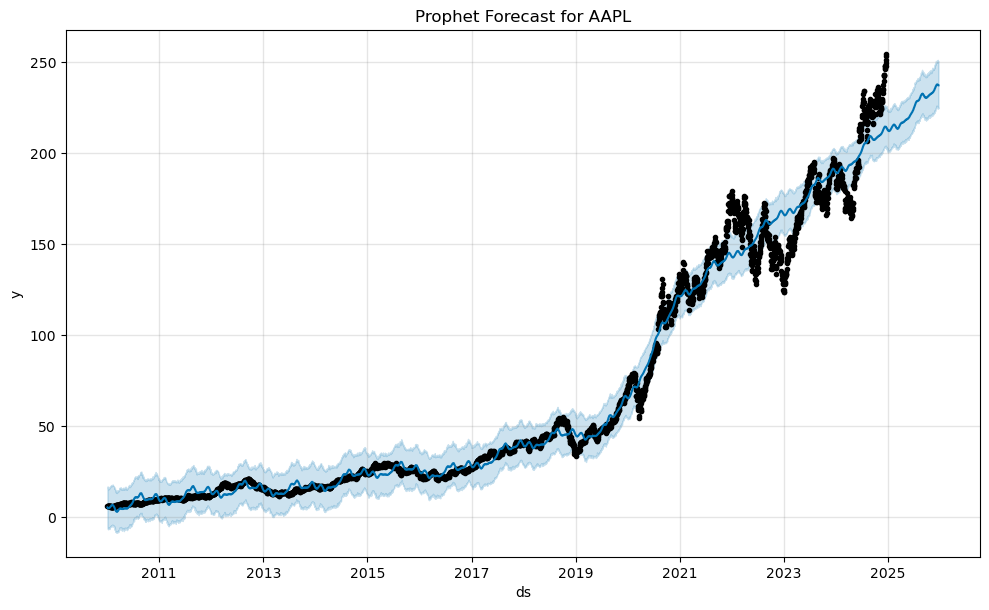

Processing MSFT...


17:18:07 - cmdstanpy - INFO - Chain [1] start processing
17:18:08 - cmdstanpy - INFO - Chain [1] done processing
/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:72: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:73: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



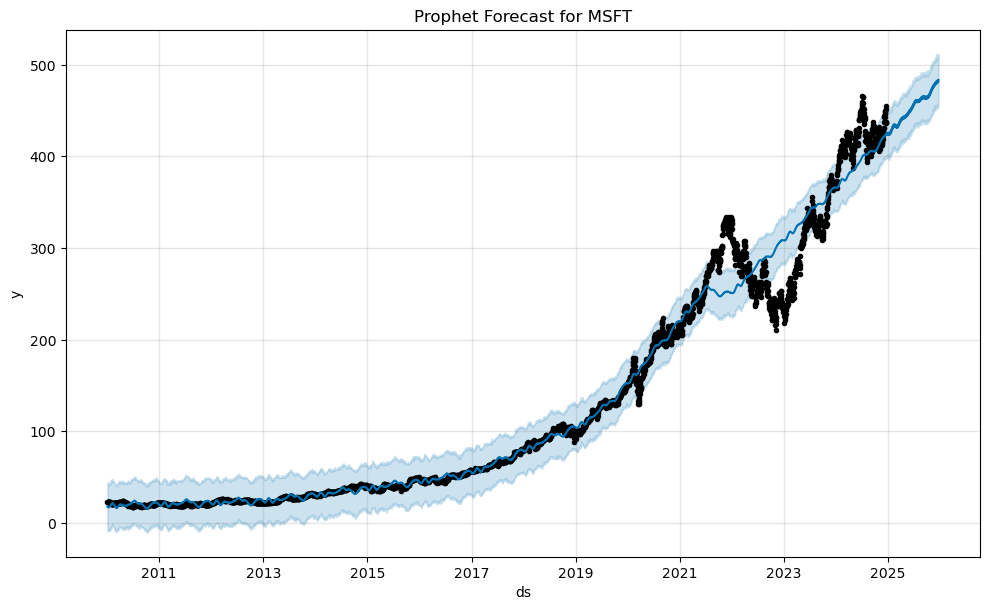

Processing GOOG...


17:18:09 - cmdstanpy - INFO - Chain [1] start processing
17:18:10 - cmdstanpy - INFO - Chain [1] done processing
/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:72: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:73: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



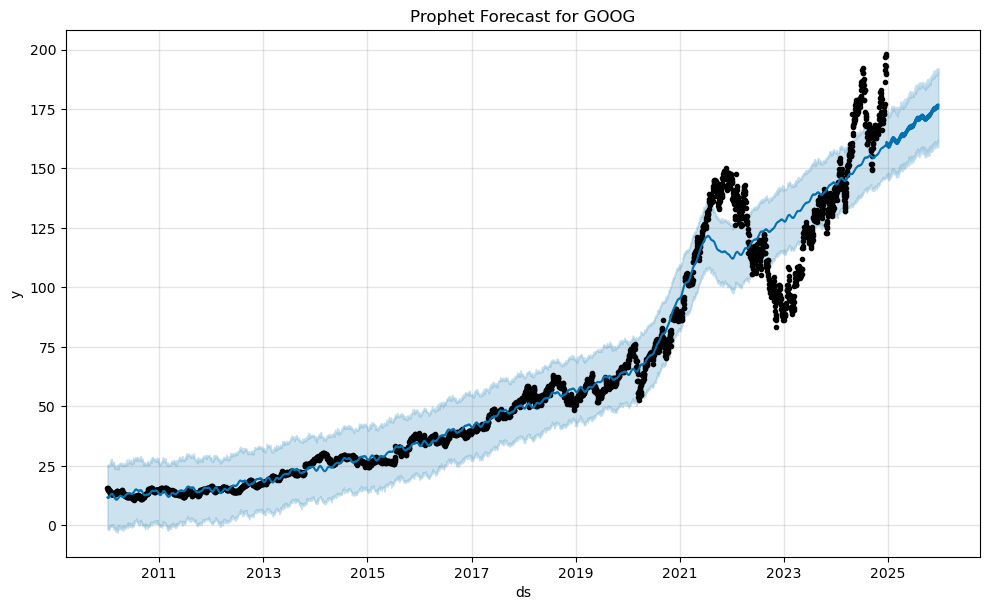

Processing ^GSPC...


17:18:11 - cmdstanpy - INFO - Chain [1] start processing
17:18:11 - cmdstanpy - INFO - Chain [1] done processing
/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:72: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:73: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



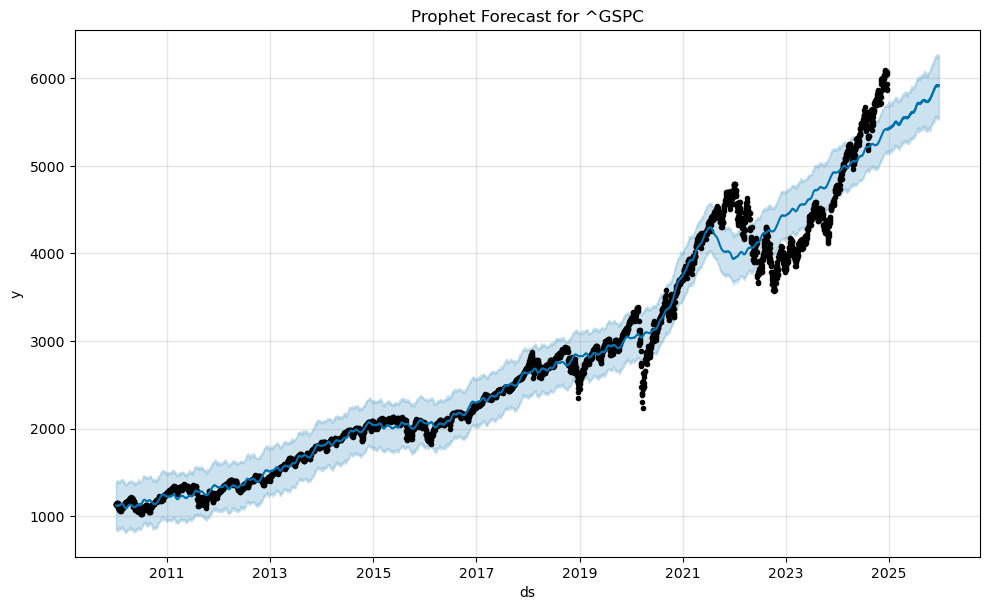

Processing ^DJI...


17:18:12 - cmdstanpy - INFO - Chain [1] start processing
17:18:13 - cmdstanpy - INFO - Chain [1] done processing
/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:72: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:73: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



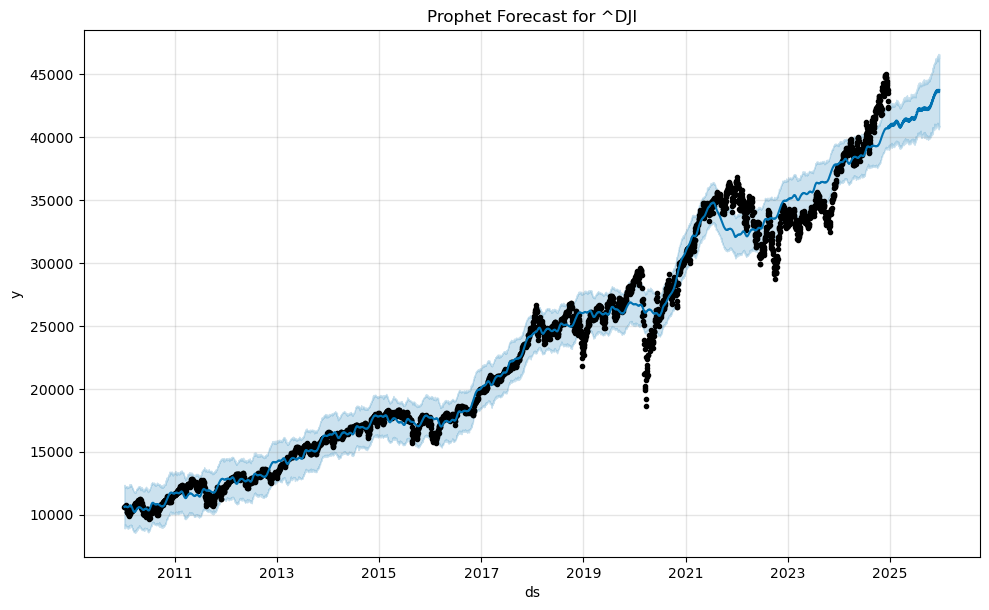

Processing ^IXIC...


17:18:14 - cmdstanpy - INFO - Chain [1] start processing
17:18:15 - cmdstanpy - INFO - Chain [1] done processing
/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:72: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:73: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



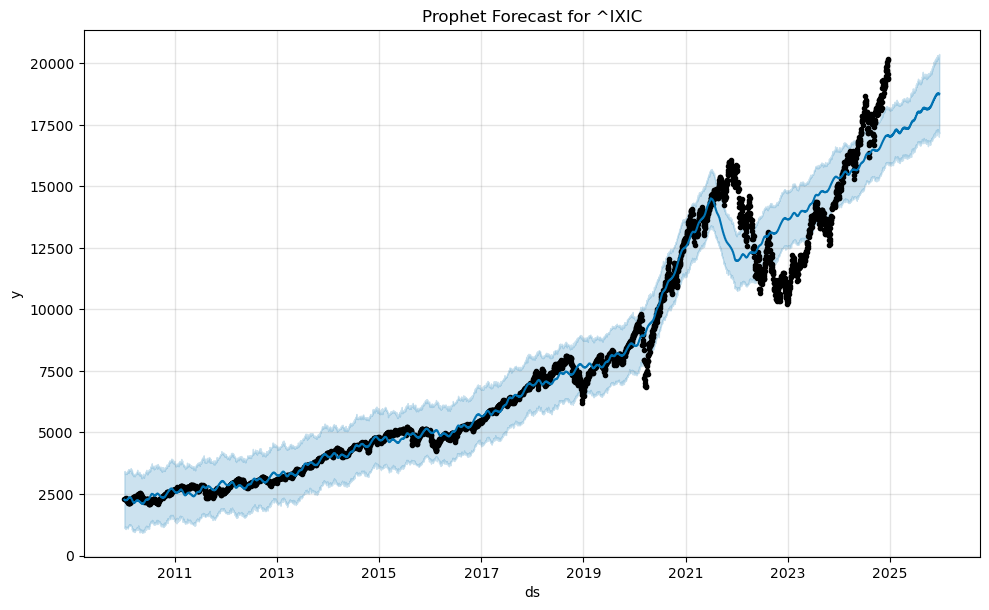

Processing ^GSPTSE...


17:18:16 - cmdstanpy - INFO - Chain [1] start processing
17:18:17 - cmdstanpy - INFO - Chain [1] done processing
/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:72: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:73: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



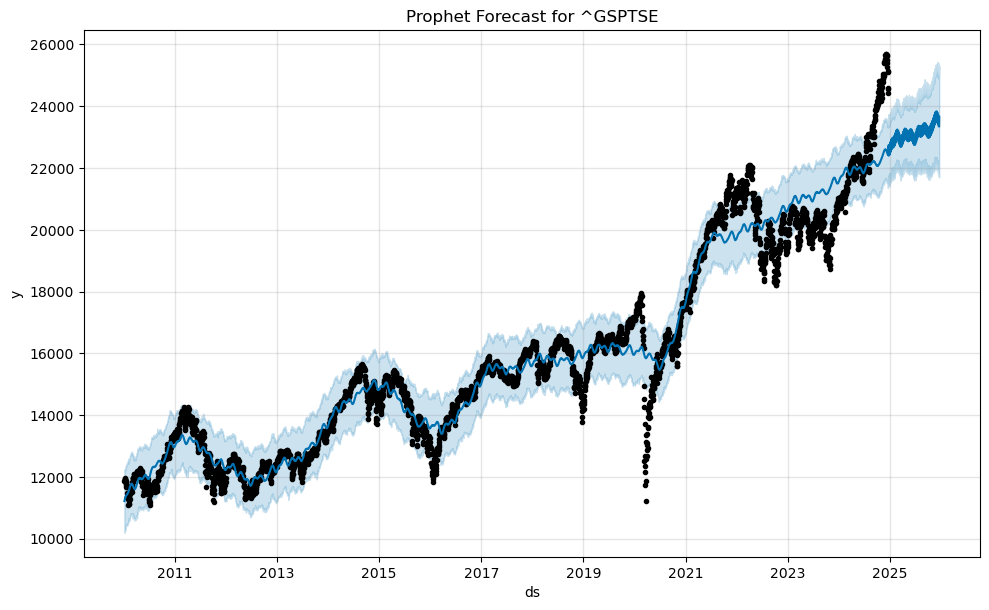

Processing ^MXX...


17:18:18 - cmdstanpy - INFO - Chain [1] start processing
17:18:18 - cmdstanpy - INFO - Chain [1] done processing
/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:72: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:73: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



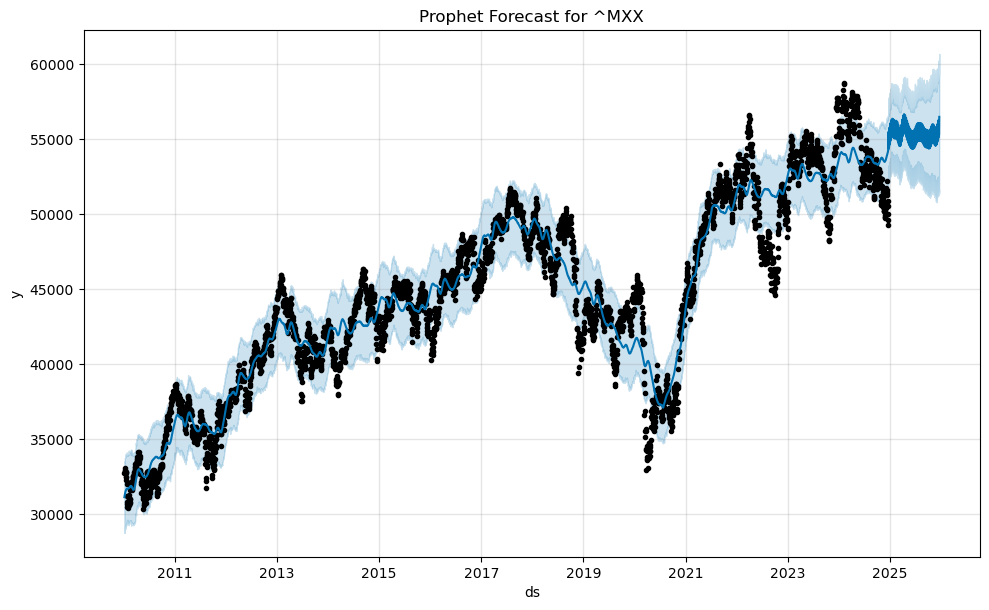

Processing ^BVSP...


17:18:19 - cmdstanpy - INFO - Chain [1] start processing
17:18:20 - cmdstanpy - INFO - Chain [1] done processing
/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:72: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:73: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



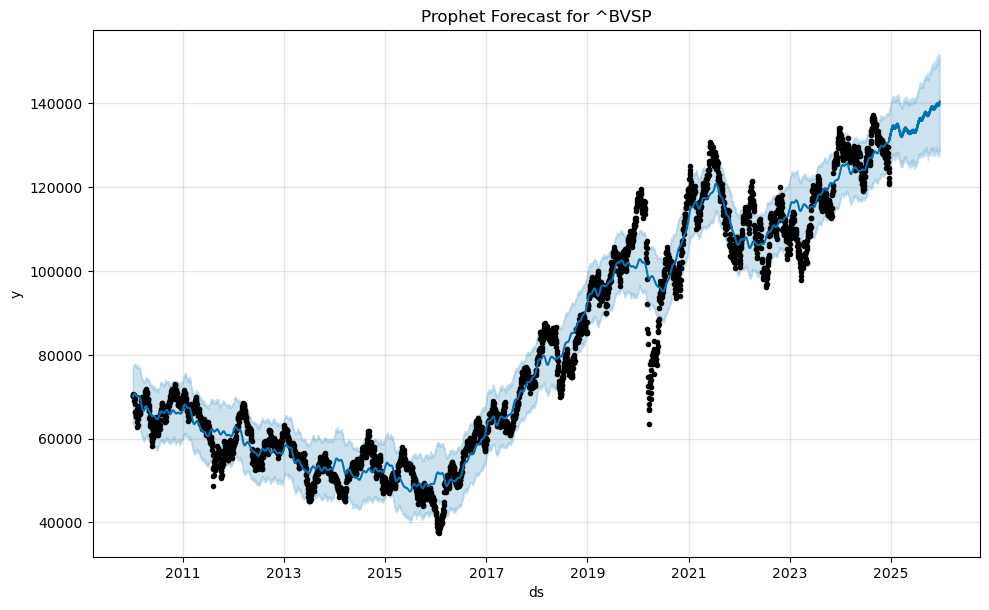

Processing ^FTSE...


17:18:21 - cmdstanpy - INFO - Chain [1] start processing
17:18:22 - cmdstanpy - INFO - Chain [1] done processing
/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:72: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:73: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



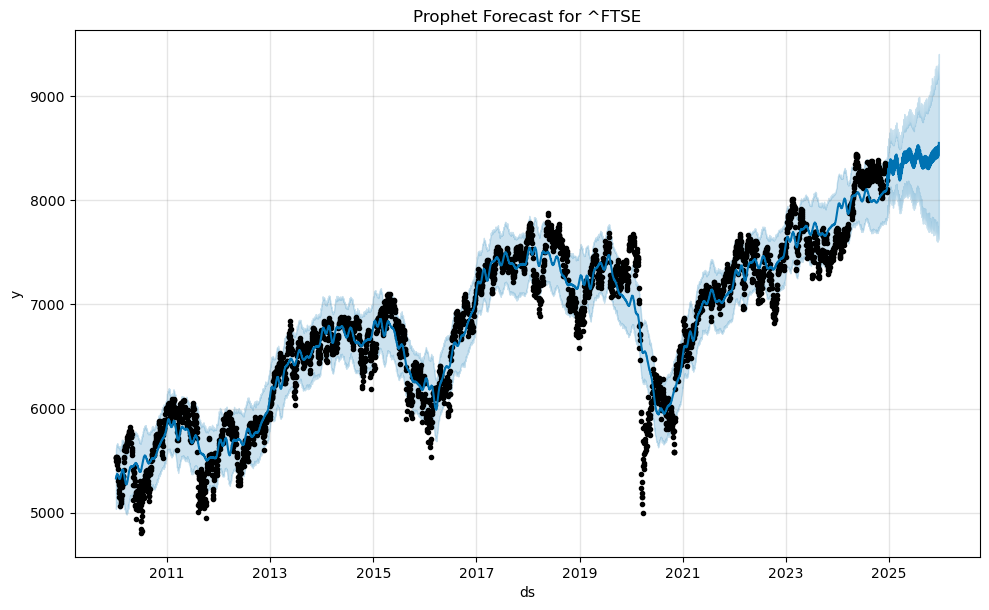

Processing ^GDAXI...


17:18:23 - cmdstanpy - INFO - Chain [1] start processing
17:18:24 - cmdstanpy - INFO - Chain [1] done processing
/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:72: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:73: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



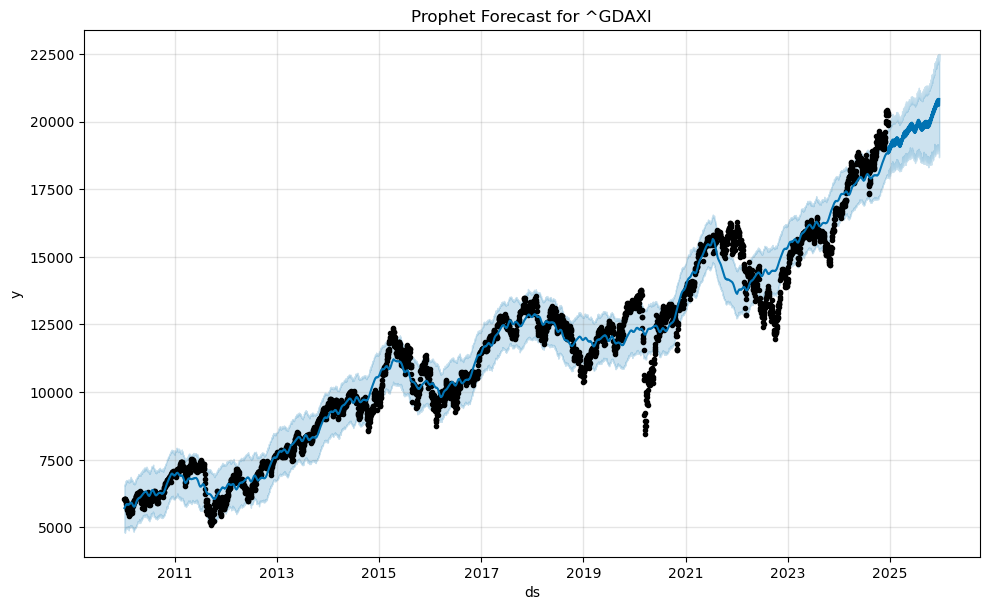

Processing ^FCHI...


17:18:25 - cmdstanpy - INFO - Chain [1] start processing
17:18:26 - cmdstanpy - INFO - Chain [1] done processing
/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:72: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:73: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



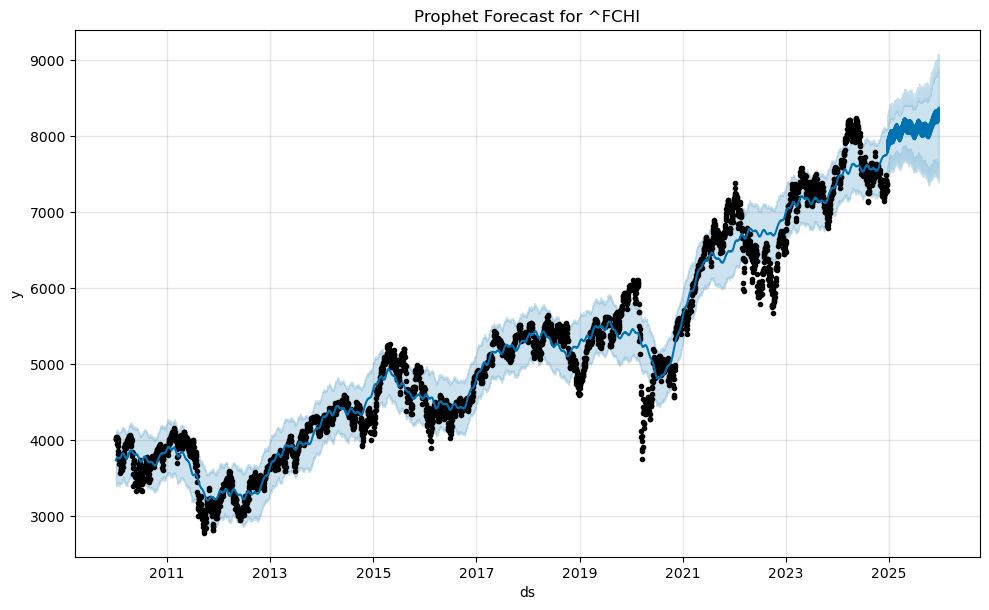

Processing ^IBEX...


17:18:27 - cmdstanpy - INFO - Chain [1] start processing
17:18:28 - cmdstanpy - INFO - Chain [1] done processing
/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:72: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:73: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



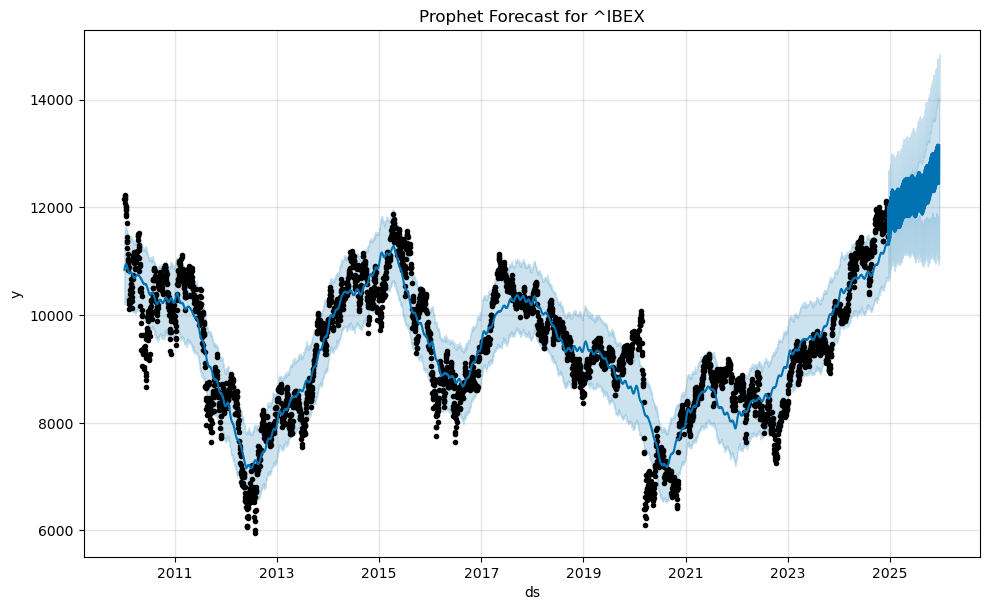

Processing ^STOXX50E...


17:18:29 - cmdstanpy - INFO - Chain [1] start processing
17:18:29 - cmdstanpy - INFO - Chain [1] done processing
/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:72: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:73: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



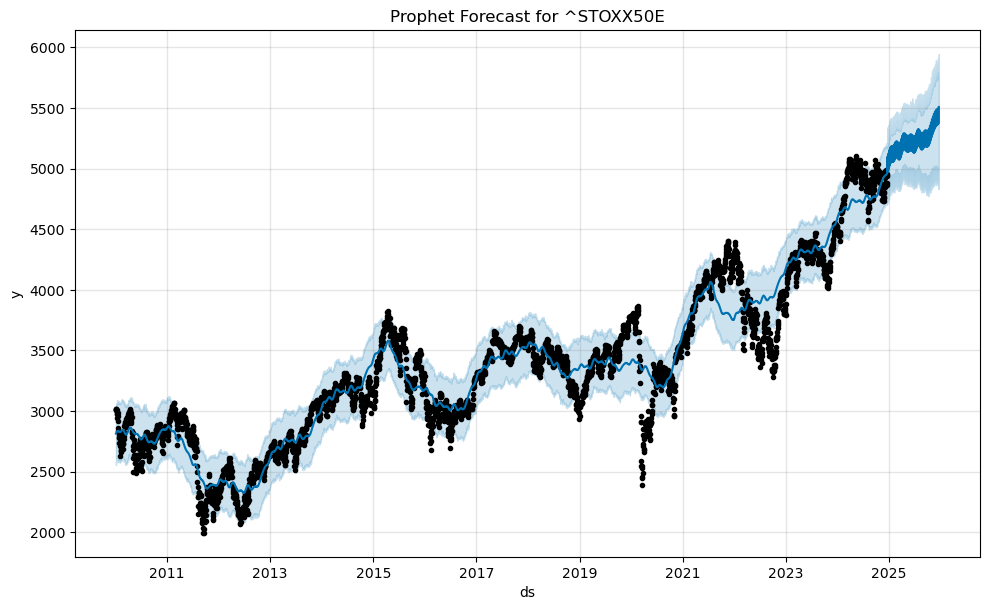

Processing FTSEMIB.MI...


17:18:30 - cmdstanpy - INFO - Chain [1] start processing
17:18:31 - cmdstanpy - INFO - Chain [1] done processing
/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:72: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:73: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



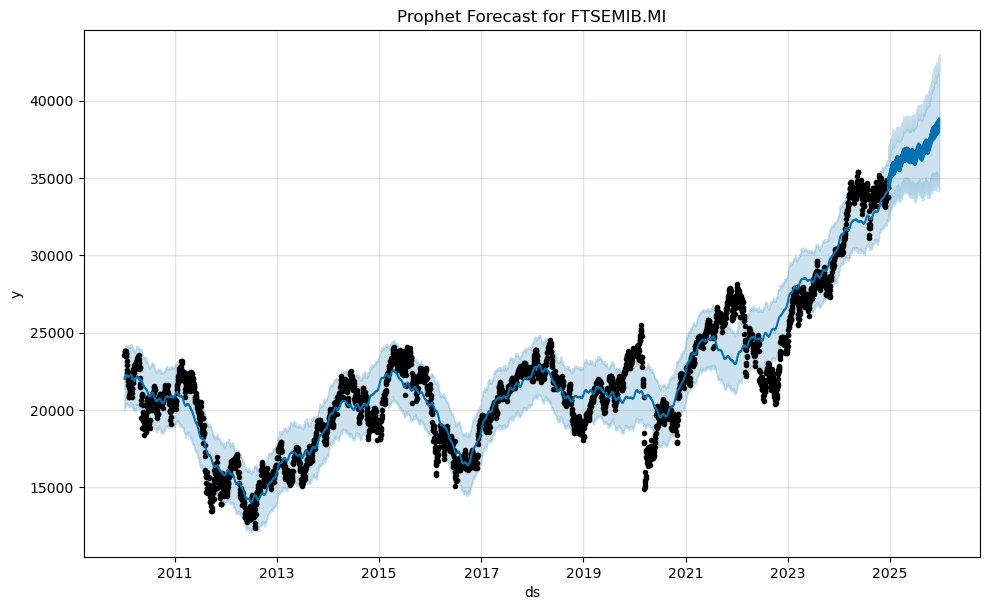

Processing ^N225...


17:18:32 - cmdstanpy - INFO - Chain [1] start processing
17:18:33 - cmdstanpy - INFO - Chain [1] done processing
/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:72: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:73: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



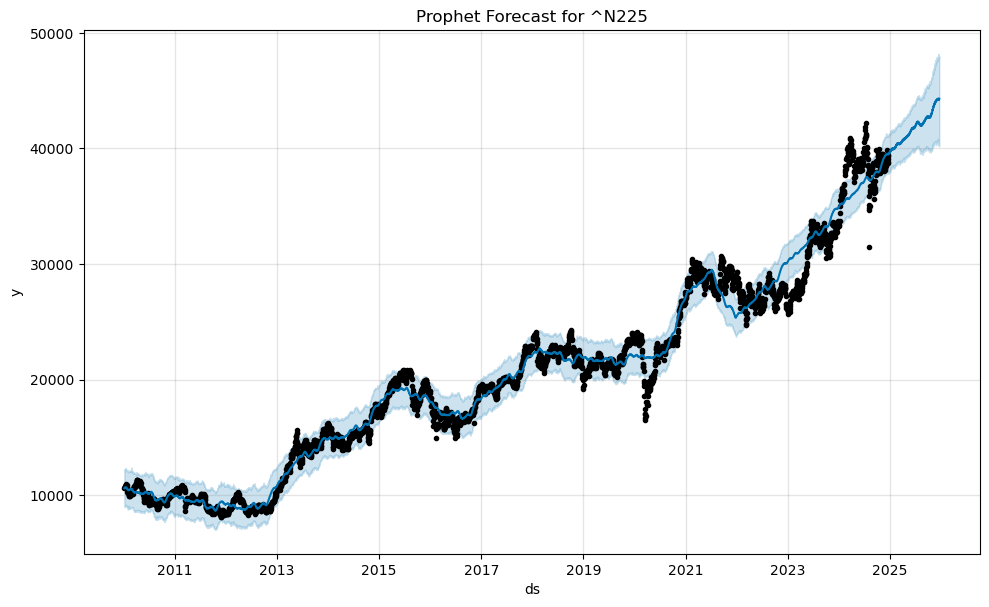

Processing ^HSI...


17:18:34 - cmdstanpy - INFO - Chain [1] start processing
17:18:35 - cmdstanpy - INFO - Chain [1] done processing
/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:72: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:73: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



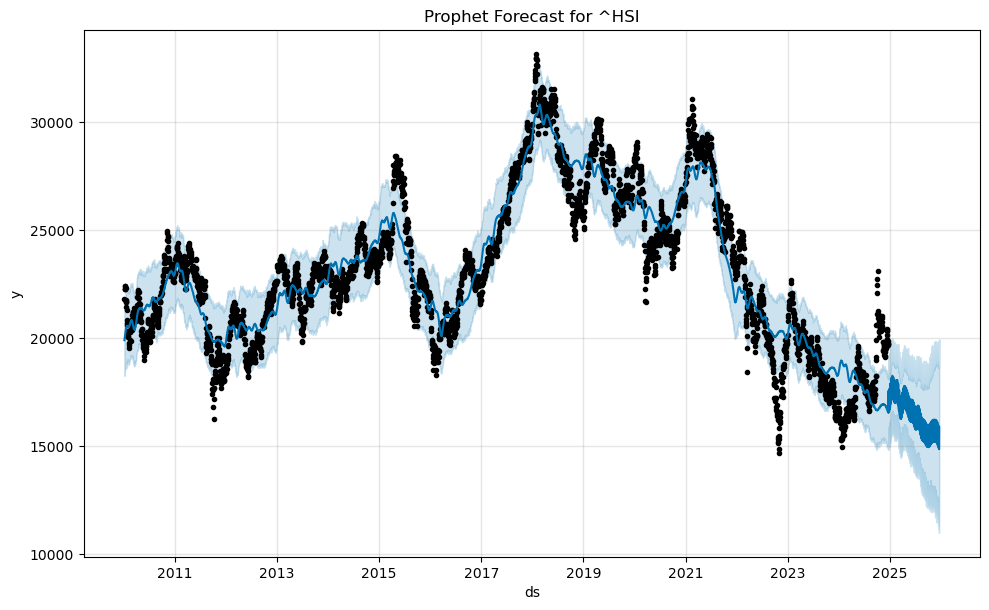

Processing 000001.SS...


17:18:36 - cmdstanpy - INFO - Chain [1] start processing
17:18:37 - cmdstanpy - INFO - Chain [1] done processing
/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:72: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:73: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



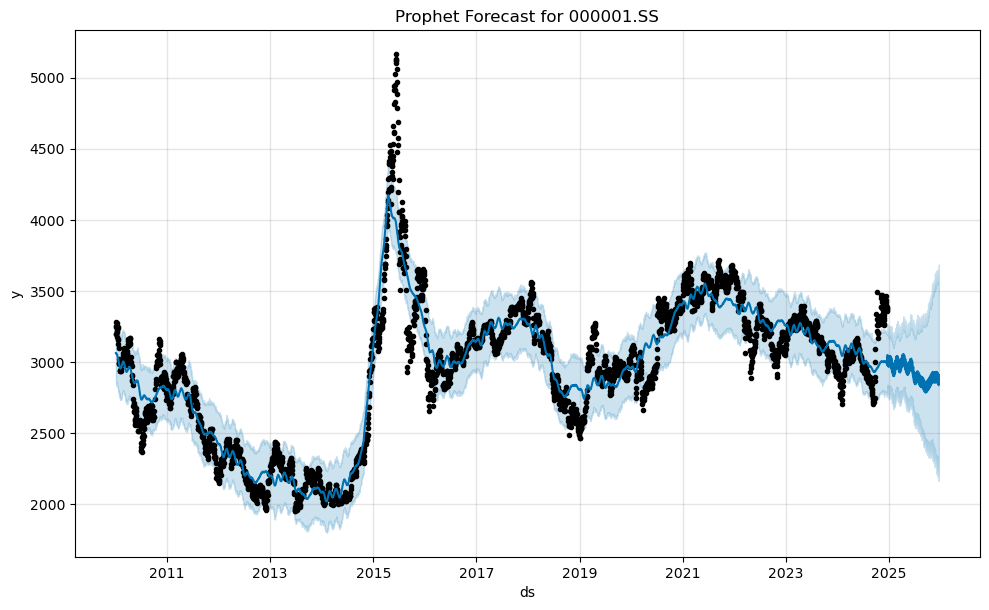

Processing ^BSESN...


17:18:38 - cmdstanpy - INFO - Chain [1] start processing
17:18:39 - cmdstanpy - INFO - Chain [1] done processing
/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:72: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:73: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



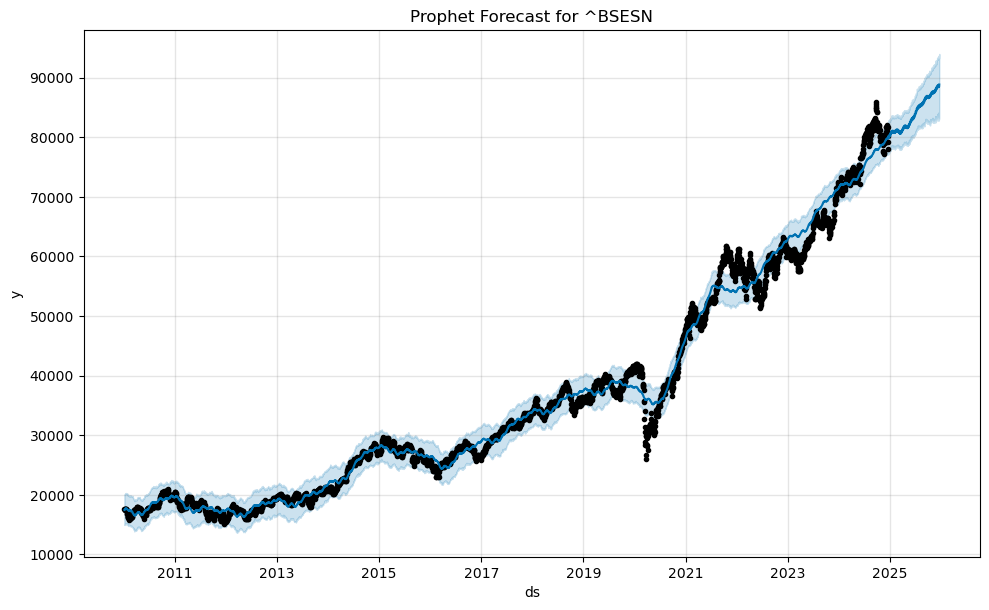

Processing ^NSEI...


17:18:40 - cmdstanpy - INFO - Chain [1] start processing
17:18:40 - cmdstanpy - INFO - Chain [1] done processing
/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:72: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:73: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



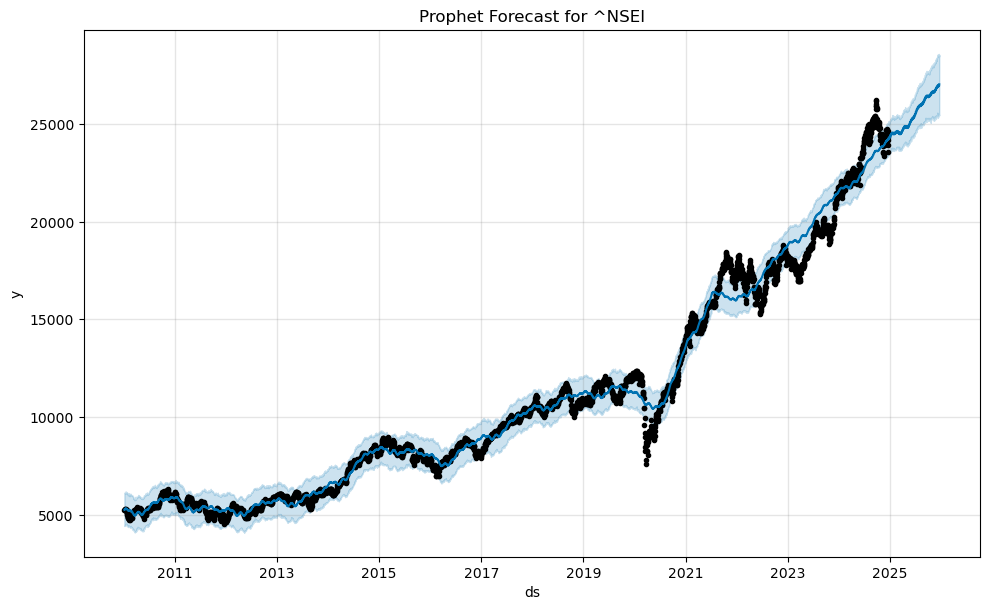

Processing ^KS11...


17:18:41 - cmdstanpy - INFO - Chain [1] start processing
17:18:42 - cmdstanpy - INFO - Chain [1] done processing
/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:72: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:73: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



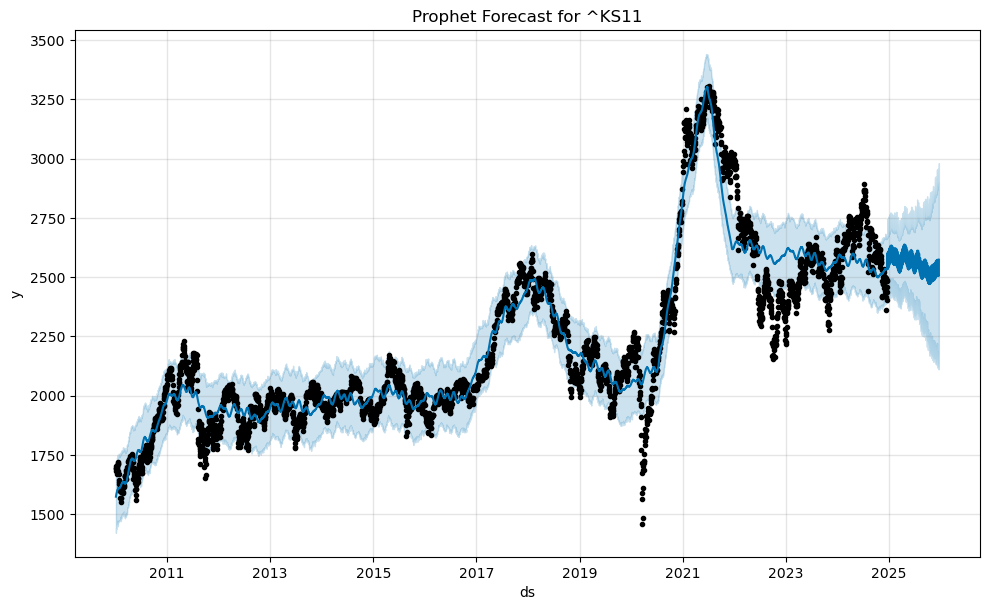

Processing ^TWII...


17:18:43 - cmdstanpy - INFO - Chain [1] start processing
17:18:44 - cmdstanpy - INFO - Chain [1] done processing
/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:72: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:73: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



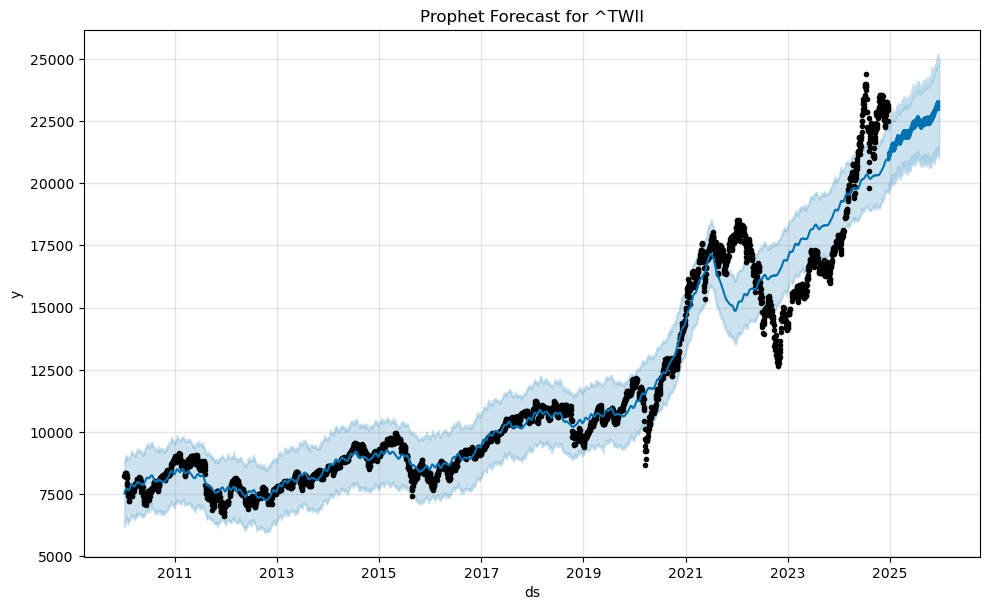

Processing ^AXJO...


17:18:45 - cmdstanpy - INFO - Chain [1] start processing
17:18:45 - cmdstanpy - INFO - Chain [1] done processing
/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:72: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/opt/anaconda3/lib/python3.11/site-packages/prophet/plot.py:73: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



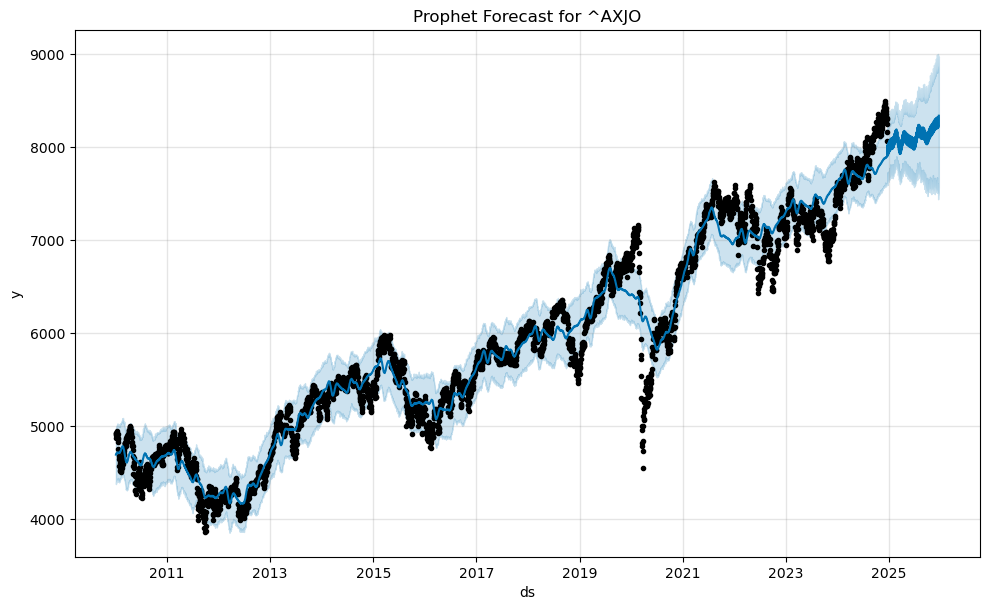

In [41]:
from prophet import Prophet
import yfinance as yf
import pandas as pd
import matplotlib.pyplot as plt

# List of tickers
assets = [
    "AAPL", "MSFT", "GOOG", "^GSPC", "^DJI", "^IXIC", "^GSPTSE", "^MXX", "^BVSP",
    "^FTSE", "^GDAXI", "^FCHI", "^IBEX", "^STOXX50E", "FTSEMIB.MI", "^N225", "^HSI",
    "000001.SS", "^BSESN", "^NSEI", "^KS11", "^TWII", "^AXJO"
]

# Loop through each ticker
for ticker in assets:
    try:
        print(f"Processing {ticker}...")

        # Download data
        data = yf.download(ticker, start="2010-01-01", progress=False)

        # Flatten MultiIndex columns if needed
        if isinstance(data.columns, pd.MultiIndex):
            data.columns = ['_'.join(col).strip() for col in data.columns]

        # Validate data
        if data.empty or f"Close_{ticker}" not in data.columns:
            print(f"No valid data for {ticker}")
            continue

        # Prepare data for Prophet
        prophet_data = data.reset_index()[['Date', f"Close_{ticker}"]].rename(columns={'Date': 'ds', f"Close_{ticker}": 'y'})
        prophet_data.dropna(inplace=True)

        # Check sufficient data points
        if len(prophet_data) < 2:
            print(f"Not enough data for {ticker}")
            continue

        # Train Prophet model
        model = Prophet()
        model.fit(prophet_data)

        # Create future dataframe
        future = model.make_future_dataframe(periods=365)

        # Forecast
        forecast = model.predict(future)

        # Plot forecast
        fig = model.plot(forecast)
        plt.title(f"Prophet Forecast for {ticker}")
        plt.show()

    except Exception as e:
        print(f"Could not process {ticker}: {e}")

Processing AAPL...


17:32:17 - cmdstanpy - INFO - Chain [1] start processing
17:32:18 - cmdstanpy - INFO - Chain [1] done processing


Processing ^GSPC...


17:32:19 - cmdstanpy - INFO - Chain [1] start processing
17:32:20 - cmdstanpy - INFO - Chain [1] done processing


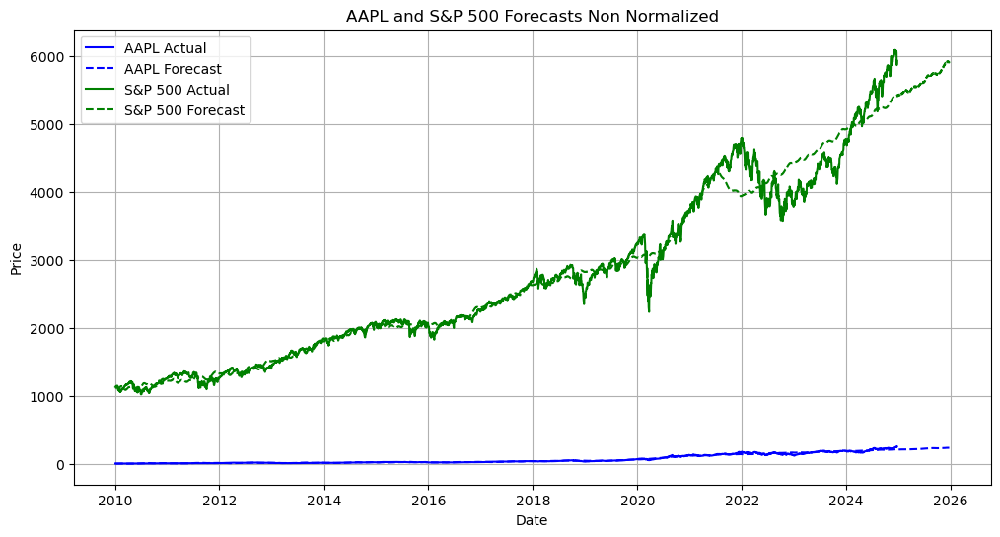

In [51]:
from prophet import Prophet
import yfinance as yf
import pandas as pd
import matplotlib.pyplot as plt

# List of tickers
assets = [
    "AAPL", "^GSPC"  # Focused only on AAPL and S&P 500 for this example
]

# Dictionary to store forecasts
forecasts = {}

# Loop through each ticker
for ticker in assets:
    try:
        print(f"Processing {ticker}...")

        # Download data
        data = yf.download(ticker, start="2010-01-01", progress=False)

        # Flatten MultiIndex columns if needed
        if isinstance(data.columns, pd.MultiIndex):
            data.columns = ['_'.join(col).strip() for col in data.columns]

        # Validate data
        if data.empty or f"Close_{ticker}" not in data.columns:
            print(f"No valid data for {ticker}")
            continue

        # Prepare data for Prophet
        prophet_data = data.reset_index()[['Date', f"Close_{ticker}"]].rename(columns={'Date': 'ds', f"Close_{ticker}": 'y'})
        prophet_data.dropna(inplace=True)

        # Check sufficient data points
        if len(prophet_data) < 2:
            print(f"Not enough data for {ticker}")
            continue

        # Train Prophet model
        model = Prophet()
        model.fit(prophet_data)

        # Create future dataframe
        future = model.make_future_dataframe(periods=365)

        # Forecast
        forecast = model.predict(future)
        forecasts[ticker] = (prophet_data, forecast)

    except Exception as e:
        print(f"Could not process {ticker}: {e}")

# Plot AAPL and S&P 500 forecasts together
if "AAPL" in forecasts and "^GSPC" in forecasts:
    aapl_actual, aapl_forecast = forecasts["AAPL"]
    gspc_actual, gspc_forecast = forecasts["^GSPC"]

    plt.figure(figsize=(12, 6))

    # Plot AAPL actual and forecast
    plt.plot(aapl_actual['ds'], aapl_actual['y'], label="AAPL Actual", color="blue")
    plt.plot(aapl_forecast['ds'], aapl_forecast['yhat'], label="AAPL Forecast", linestyle="--", color="blue")

    # Plot S&P 500 actual and forecast
    plt.plot(gspc_actual['ds'], gspc_actual['y'], label="S&P 500 Actual", color="green")
    plt.plot(gspc_forecast['ds'], gspc_forecast['yhat'], label="S&P 500 Forecast", linestyle="--", color="green")

    # Add titles and labels
    plt.title("AAPL and S&P 500 Forecasts Non Normalized")
    plt.xlabel("Date")
    plt.ylabel("Price")
    plt.legend()
    plt.grid()

    # Show plot
    plt.show()
else:
    print("Forecasts for AAPL or S&P 500 are missing.")

In [52]:
from prophet import Prophet
import yfinance as yf
import pandas as pd
import plotly.graph_objects as go

# List of tickers
assets = [
    "AAPL", "^GSPC"  # Focused only on AAPL and S&P 500 for this example
]

# Dictionary to store forecasts
forecasts = {}

# Loop through each ticker
for ticker in assets:
    try:
        print(f"Processing {ticker}...")

        # Download data
        data = yf.download(ticker, start="2010-01-01", progress=False)

        # Flatten MultiIndex columns if needed
        if isinstance(data.columns, pd.MultiIndex):
            data.columns = ['_'.join(col).strip() for col in data.columns]

        # Validate data
        if data.empty or f"Close_{ticker}" not in data.columns:
            print(f"No valid data for {ticker}")
            continue

        # Prepare data for Prophet
        prophet_data = data.reset_index()[['Date', f"Close_{ticker}"]].rename(columns={'Date': 'ds', f"Close_{ticker}": 'y'})
        prophet_data.dropna(inplace=True)

        # Check sufficient data points
        if len(prophet_data) < 2:
            print(f"Not enough data for {ticker}")
            continue

        # Train Prophet model
        model = Prophet()
        model.fit(prophet_data)

        # Create future dataframe
        future = model.make_future_dataframe(periods=365)

        # Forecast
        forecast = model.predict(future)
        forecasts[ticker] = (prophet_data, forecast)

    except Exception as e:
        print(f"Could not process {ticker}: {e}")

# Plot AAPL and S&P 500 forecasts together
if "AAPL" in forecasts and "^GSPC" in forecasts:
    aapl_actual, aapl_forecast = forecasts["AAPL"]
    gspc_actual, gspc_forecast = forecasts["^GSPC"]

    # Create a Plotly figure
    fig = go.Figure()

    # AAPL actual and forecast
    fig.add_trace(go.Scatter(x=aapl_actual['ds'], y=aapl_actual['y'],
                             mode='lines', name="AAPL Actual", line=dict(color='blue')))
    fig.add_trace(go.Scatter(x=aapl_forecast['ds'], y=aapl_forecast['yhat'],
                             mode='lines', name="AAPL Forecast", line=dict(color='blue', dash='dash')))

    # S&P 500 actual and forecast
    fig.add_trace(go.Scatter(x=gspc_actual['ds'], y=gspc_actual['y'],
                             mode='lines', name="S&P 500 Actual", line=dict(color='green')))
    fig.add_trace(go.Scatter(x=gspc_forecast['ds'], y=gspc_forecast['yhat'],
                             mode='lines', name="S&P 500 Forecast", line=dict(color='green', dash='dash')))

    # Customize layout
    fig.update_layout(
        title="AAPL and S&P 500 Forecasts (Non-Normalized)",
        xaxis_title="Date",
        yaxis_title="Price",
        plot_bgcolor="black",
        paper_bgcolor="black",
        font=dict(color="white"),
        legend=dict(
            x=0.01, y=0.99,
            bgcolor="rgba(0,0,0,0)",
            font=dict(color="white")
        )
    )

    # Show the plot
    fig.show()
else:
    print("Forecasts for AAPL or S&P 500 are missing.")

Processing AAPL...


17:33:48 - cmdstanpy - INFO - Chain [1] start processing
17:33:49 - cmdstanpy - INFO - Chain [1] done processing


Processing ^GSPC...


17:33:50 - cmdstanpy - INFO - Chain [1] start processing
17:33:50 - cmdstanpy - INFO - Chain [1] done processing


Processing AAPL...


17:23:03 - cmdstanpy - INFO - Chain [1] start processing
17:23:04 - cmdstanpy - INFO - Chain [1] done processing


Processing ^GSPC...


17:23:05 - cmdstanpy - INFO - Chain [1] start processing
17:23:05 - cmdstanpy - INFO - Chain [1] done processing


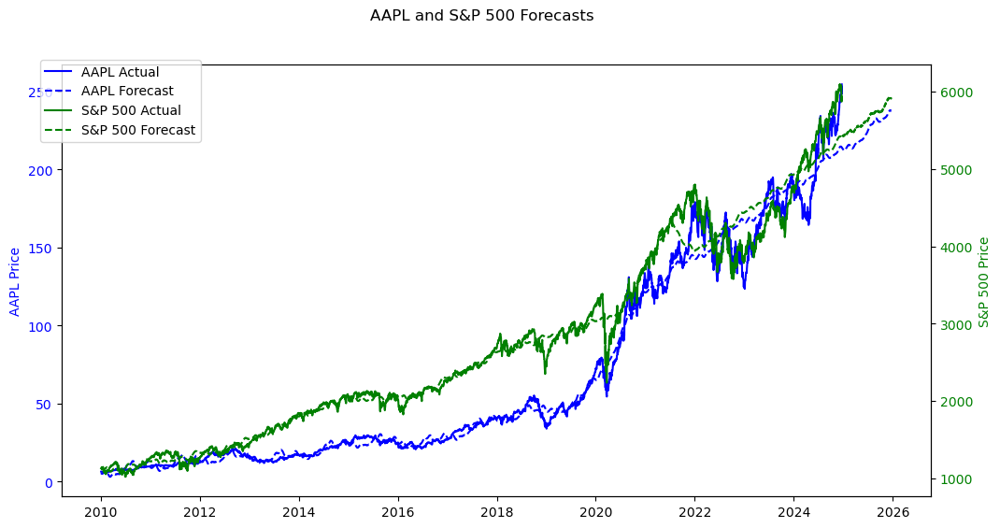

In [43]:
from prophet import Prophet
import yfinance as yf
import pandas as pd
import matplotlib.pyplot as plt

# List of tickers
assets = [
    "AAPL", "^GSPC"  # Focused only on AAPL and S&P 500 for this example
]

# Dictionary to store forecasts
forecasts = {}

# Loop through each ticker
for ticker in assets:
    try:
        print(f"Processing {ticker}...")

        # Download data
        data = yf.download(ticker, start="2010-01-01", progress=False)

        # Flatten MultiIndex columns if needed
        if isinstance(data.columns, pd.MultiIndex):
            data.columns = ['_'.join(col).strip() for col in data.columns]

        # Validate data
        if data.empty or f"Close_{ticker}" not in data.columns:
            print(f"No valid data for {ticker}")
            continue

        # Prepare data for Prophet
        prophet_data = data.reset_index()[['Date', f"Close_{ticker}"]].rename(columns={'Date': 'ds', f"Close_{ticker}": 'y'})
        prophet_data.dropna(inplace=True)

        # Check sufficient data points
        if len(prophet_data) < 2:
            print(f"Not enough data for {ticker}")
            continue

        # Train Prophet model
        model = Prophet()
        model.fit(prophet_data)

        # Create future dataframe
        future = model.make_future_dataframe(periods=365)

        # Forecast
        forecast = model.predict(future)
        forecasts[ticker] = (prophet_data, forecast)

    except Exception as e:
        print(f"Could not process {ticker}: {e}")

# Plot AAPL and S&P 500 forecasts with dual y-axes
if "AAPL" in forecasts and "^GSPC" in forecasts:
    aapl_actual, aapl_forecast = forecasts["AAPL"]
    gspc_actual, gspc_forecast = forecasts["^GSPC"]

    fig, ax1 = plt.subplots(figsize=(12, 6))

    # Plot AAPL on primary y-axis
    ax1.plot(aapl_actual['ds'], aapl_actual['y'], label="AAPL Actual", color="blue")
    ax1.plot(aapl_forecast['ds'], aapl_forecast['yhat'], label="AAPL Forecast", linestyle="--", color="blue")
    ax1.set_ylabel("AAPL Price", color="blue")
    ax1.tick_params(axis="y", labelcolor="blue")

    # Create secondary y-axis for S&P 500
    ax2 = ax1.twinx()
    ax2.plot(gspc_actual['ds'], gspc_actual['y'], label="S&P 500 Actual", color="green")
    ax2.plot(gspc_forecast['ds'], gspc_forecast['yhat'], label="S&P 500 Forecast", linestyle="--", color="green")
    ax2.set_ylabel("S&P 500 Price", color="green")
    ax2.tick_params(axis="y", labelcolor="green")

    # Add title and legend
    fig.suptitle("AAPL and S&P 500 Forecasts")
    fig.legend(loc="upper left", bbox_to_anchor=(0.1, 0.9))
    plt.show()
else:
    print("Forecasts for AAPL or S&P 500 are missing.")

In [53]:
from prophet import Prophet
import yfinance as yf
import pandas as pd
import plotly.graph_objects as go

# List of tickers
assets = [
    "AAPL", "^GSPC"  # Focused only on AAPL and S&P 500 for this example
]

# Dictionary to store forecasts
forecasts = {}

# Loop through each ticker
for ticker in assets:
    try:
        print(f"Processing {ticker}...")

        # Download data
        data = yf.download(ticker, start="2010-01-01", progress=False)

        # Flatten MultiIndex columns if needed
        if isinstance(data.columns, pd.MultiIndex):
            data.columns = ['_'.join(col).strip() for col in data.columns]

        # Validate data
        if data.empty or f"Close_{ticker}" not in data.columns:
            print(f"No valid data for {ticker}")
            continue

        # Prepare data for Prophet
        prophet_data = data.reset_index()[['Date', f"Close_{ticker}"]].rename(columns={'Date': 'ds', f"Close_{ticker}": 'y'})
        prophet_data.dropna(inplace=True)

        # Check sufficient data points
        if len(prophet_data) < 2:
            print(f"Not enough data for {ticker}")
            continue

        # Train Prophet model
        model = Prophet()
        model.fit(prophet_data)

        # Create future dataframe
        future = model.make_future_dataframe(periods=365)

        # Forecast
        forecast = model.predict(future)
        forecasts[ticker] = (prophet_data, forecast)

    except Exception as e:
        print(f"Could not process {ticker}: {e}")

# Plot AAPL and S&P 500 forecasts with dual y-axes
if "AAPL" in forecasts and "^GSPC" in forecasts:
    aapl_actual, aapl_forecast = forecasts["AAPL"]
    gspc_actual, gspc_forecast = forecasts["^GSPC"]

    # Create a Plotly figure
    fig = go.Figure()

    # AAPL actual and forecast
    fig.add_trace(go.Scatter(x=aapl_actual['ds'], y=aapl_actual['y'],
                             mode='lines', name="AAPL Actual", line=dict(color='blue'), yaxis="y1"))
    fig.add_trace(go.Scatter(x=aapl_forecast['ds'], y=aapl_forecast['yhat'],
                             mode='lines', name="AAPL Forecast", line=dict(color='blue', dash='dash'), yaxis="y1"))

    # S&P 500 actual and forecast
    fig.add_trace(go.Scatter(x=gspc_actual['ds'], y=gspc_actual['y'],
                             mode='lines', name="S&P 500 Actual", line=dict(color='green'), yaxis="y2"))
    fig.add_trace(go.Scatter(x=gspc_forecast['ds'], y=gspc_forecast['yhat'],
                             mode='lines', name="S&P 500 Forecast", line=dict(color='green', dash='dash'), yaxis="y2"))

    # Update layout for dual y-axes
    fig.update_layout(
        title="AAPL and S&P 500 Forecasts with Dual Y-Axis",
        xaxis=dict(title="Date"),
        yaxis=dict(title="AAPL Price", titlefont=dict(color="blue"), tickfont=dict(color="blue")),
        yaxis2=dict(title="S&P 500 Price", titlefont=dict(color="green"), tickfont=dict(color="green"),
                    anchor="x", overlaying="y", side="right"),
        plot_bgcolor="black",
        paper_bgcolor="black",
        font=dict(color="white"),
        legend=dict(
            x=0.01, y=0.99,
            bgcolor="rgba(0,0,0,0)",
            font=dict(color="white")
        )
    )

    # Show the plot
    fig.show()
else:
    print("Forecasts for AAPL or S&P 500 are missing.")

Processing AAPL...


17:35:02 - cmdstanpy - INFO - Chain [1] start processing
17:35:02 - cmdstanpy - INFO - Chain [1] done processing


Processing ^GSPC...


17:35:03 - cmdstanpy - INFO - Chain [1] start processing
17:35:04 - cmdstanpy - INFO - Chain [1] done processing


Processing AAPL...


17:28:46 - cmdstanpy - INFO - Chain [1] start processing


Columns for AAPL: MultiIndex([( 'Close', 'AAPL'),
            (  'High', 'AAPL'),
            (   'Low', 'AAPL'),
            (  'Open', 'AAPL'),
            ('Volume', 'AAPL')],
           names=['Price', 'Ticker'])


17:28:46 - cmdstanpy - INFO - Chain [1] done processing


Processing ^GSPC...


17:28:47 - cmdstanpy - INFO - Chain [1] start processing


Columns for ^GSPC: MultiIndex([( 'Close', '^GSPC'),
            (  'High', '^GSPC'),
            (   'Low', '^GSPC'),
            (  'Open', '^GSPC'),
            ('Volume', '^GSPC')],
           names=['Price', 'Ticker'])


17:28:48 - cmdstanpy - INFO - Chain [1] done processing


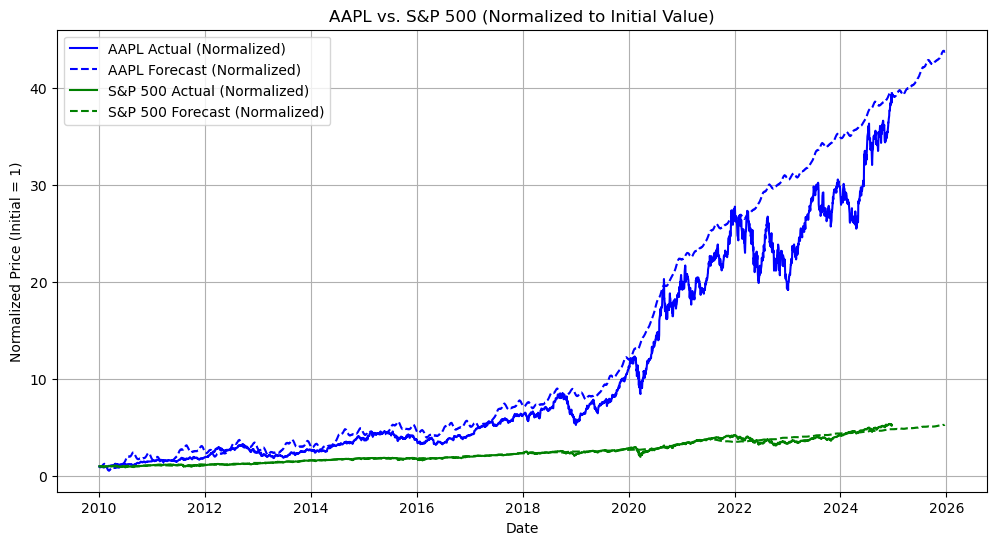

In [50]:
from prophet import Prophet
import yfinance as yf
import pandas as pd
import matplotlib.pyplot as plt

# List of tickers
assets = ["AAPL", "^GSPC"]

# Dictionary to store forecasts
forecasts = {}

# Loop through each ticker
for ticker in assets:
    try:
        print(f"Processing {ticker}...")

        # Download data
        data = yf.download(ticker, start="2010-01-01", progress=False)

        # Print column names for debugging
        print(f"Columns for {ticker}: {data.columns}")

        # Flatten MultiIndex columns
        if isinstance(data.columns, pd.MultiIndex):
            data.columns = [col[0] for col in data.columns]

        # Validate data
        if data.empty or "Close" not in data.columns:
            print(f"No valid data for {ticker}")
            continue

        # Prepare data for Prophet
        prophet_data = data.reset_index()[['Date', 'Close']].rename(columns={'Date': 'ds', 'Close': 'y'})
        prophet_data.dropna(inplace=True)

        # Check sufficient data points
        if len(prophet_data) < 2:
            print(f"Not enough data for {ticker}")
            continue

        # Train Prophet model
        model = Prophet()
        model.fit(prophet_data)

        # Create future dataframe
        future = model.make_future_dataframe(periods=365)

        # Forecast
        forecast = model.predict(future)
        forecasts[ticker] = (prophet_data, forecast)

    except Exception as e:
        print(f"Could not process {ticker}: {e}")

# Normalize and plot AAPL and S&P 500
if "AAPL" in forecasts and "^GSPC" in forecasts:
    aapl_actual, aapl_forecast = forecasts["AAPL"]
    gspc_actual, gspc_forecast = forecasts["^GSPC"]

    # Normalize the data (set initial value to 1 for comparison)
    aapl_actual['y_norm'] = aapl_actual['y'] / aapl_actual['y'].iloc[0]
    aapl_forecast['yhat_norm'] = aapl_forecast['yhat'] / aapl_forecast['yhat'].iloc[0]
    gspc_actual['y_norm'] = gspc_actual['y'] / gspc_actual['y'].iloc[0]
    gspc_forecast['yhat_norm'] = gspc_forecast['yhat'] / gspc_forecast['yhat'].iloc[0]

    # Plot normalized data
    plt.figure(figsize=(12, 6))
    plt.plot(aapl_actual['ds'], aapl_actual['y_norm'], label="AAPL Actual (Normalized)", color="blue")
    plt.plot(aapl_forecast['ds'], aapl_forecast['yhat_norm'], label="AAPL Forecast (Normalized)", linestyle="--", color="blue")
    plt.plot(gspc_actual['ds'], gspc_actual['y_norm'], label="S&P 500 Actual (Normalized)", color="green")
    plt.plot(gspc_forecast['ds'], gspc_forecast['yhat_norm'], label="S&P 500 Forecast (Normalized)", linestyle="--", color="green")

    # Add labels, title, and legend
    plt.title("AAPL vs. S&P 500 (Normalized to Initial Value)")
    plt.xlabel("Date")
    plt.ylabel("Normalized Price (Initial = 1)")
    plt.legend()
    plt.grid()
    plt.show()
else:
    print("Forecasts for AAPL or S&P 500 are missing.")

In [54]:
from prophet import Prophet
import yfinance as yf
import pandas as pd
import plotly.graph_objects as go

# List of tickers
assets = ["AAPL", "^GSPC"]

# Dictionary to store forecasts
forecasts = {}

# Loop through each ticker
for ticker in assets:
    try:
        print(f"Processing {ticker}...")

        # Download data
        data = yf.download(ticker, start="2010-01-01", progress=False)

        # Flatten MultiIndex columns
        if isinstance(data.columns, pd.MultiIndex):
            data.columns = [col[0] for col in data.columns]

        # Validate data
        if data.empty or "Close" not in data.columns:
            print(f"No valid data for {ticker}")
            continue

        # Prepare data for Prophet
        prophet_data = data.reset_index()[['Date', 'Close']].rename(columns={'Date': 'ds', 'Close': 'y'})
        prophet_data.dropna(inplace=True)

        # Check sufficient data points
        if len(prophet_data) < 2:
            print(f"Not enough data for {ticker}")
            continue

        # Train Prophet model
        model = Prophet()
        model.fit(prophet_data)

        # Create future dataframe
        future = model.make_future_dataframe(periods=365)

        # Forecast
        forecast = model.predict(future)
        forecasts[ticker] = (prophet_data, forecast)

    except Exception as e:
        print(f"Could not process {ticker}: {e}")

# Normalize and plot AAPL and S&P 500
if "AAPL" in forecasts and "^GSPC" in forecasts:
    aapl_actual, aapl_forecast = forecasts["AAPL"]
    gspc_actual, gspc_forecast = forecasts["^GSPC"]

    # Normalize the data (set initial value to 1 for comparison)
    aapl_actual['y_norm'] = aapl_actual['y'] / aapl_actual['y'].iloc[0]
    aapl_forecast['yhat_norm'] = aapl_forecast['yhat'] / aapl_forecast['yhat'].iloc[0]
    gspc_actual['y_norm'] = gspc_actual['y'] / gspc_actual['y'].iloc[0]
    gspc_forecast['yhat_norm'] = gspc_forecast['yhat'] / gspc_forecast['yhat'].iloc[0]

    # Create a Plotly figure
    fig = go.Figure()

    # AAPL actual and forecast (normalized)
    fig.add_trace(go.Scatter(x=aapl_actual['ds'], y=aapl_actual['y_norm'],
                             mode='lines', name="AAPL Actual (Normalized)", line=dict(color='blue')))
    fig.add_trace(go.Scatter(x=aapl_forecast['ds'], y=aapl_forecast['yhat_norm'],
                             mode='lines', name="AAPL Forecast (Normalized)", line=dict(color='blue', dash='dash')))

    # S&P 500 actual and forecast (normalized)
    fig.add_trace(go.Scatter(x=gspc_actual['ds'], y=gspc_actual['y_norm'],
                             mode='lines', name="S&P 500 Actual (Normalized)", line=dict(color='green')))
    fig.add_trace(go.Scatter(x=gspc_forecast['ds'], y=gspc_forecast['yhat_norm'],
                             mode='lines', name="S&P 500 Forecast (Normalized)", line=dict(color='green', dash='dash')))

    # Update layout for dark background
    fig.update_layout(
        title="AAPL vs. S&P 500 (Normalized to Initial Value)",
        xaxis=dict(title="Date"),
        yaxis=dict(title="Normalized Price (Initial = 1)"),
        plot_bgcolor="black",
        paper_bgcolor="black",
        font=dict(color="white"),
        legend=dict(
            x=0.01, y=0.99,
            bgcolor="rgba(0,0,0,0)",
            font=dict(color="white")
        )
    )

    # Show the plot
    fig.show()
else:
    print("Forecasts for AAPL or S&P 500 are missing.")

Processing AAPL...


17:37:57 - cmdstanpy - INFO - Chain [1] start processing
17:37:58 - cmdstanpy - INFO - Chain [1] done processing


Processing ^GSPC...


17:37:59 - cmdstanpy - INFO - Chain [1] start processing
17:37:59 - cmdstanpy - INFO - Chain [1] done processing
